In [643]:
import numpy as np
import scipy as sp
from scipy.linalg import toeplitz, cholesky
from scipy.special import beta, gamma, kv  # kv is BesselK
import Lagrangian_TSM_Drifter as LTD
import h5py
import matplotlib.pyplot as plt
from scipy.optimize import minimize

from scipy.signal import periodogram
from sklearn.metrics import mean_squared_error


import numpy as np
import scipy as sp
import scipy.io
from scipy.linalg import toeplitz, cholesky
from scipy.special import beta, gamma, kv  # kv is BesselK
import Lagrangian_TSM_Drifter as LTD
import h5py
import matplotlib.pyplot as plt
from scipy.optimize import minimize

from scipy.signal import periodogram
from sklearn.metrics import mean_squared_error

In [1174]:
from scipy.io import loadmat
import cartopy.crs as ccrs
import cartopy.feature as cfeature

ulysses_data = loadmat("/Users/syx/Desktop/Imperial College London UG/Year4/MATH70050 M4R/Data and Codes/Activity/OceanDrifterDataInR/drifterulysses.mat")
ulysses = ulysses_data["drifterulysses"][0][0]
ulysses_lat = ulysses["lat"].flatten()
ulysses_lon = ulysses["lon"].flatten()
ulysses_vel = ulysses["cv"].flatten()



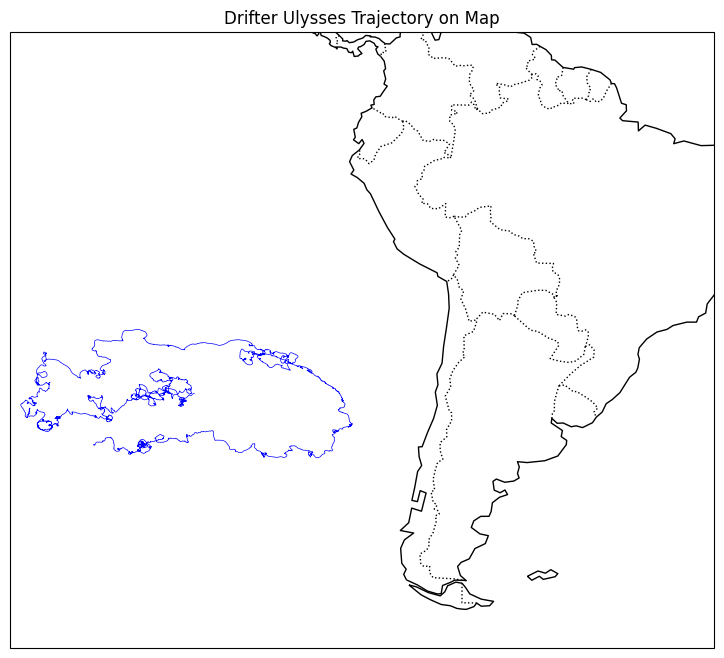

In [1175]:
# Plot drifter trajectory for ulysses on a map
fig = plt.figure(figsize=(12, 8))
ax = plt.axes(projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS, linestyle=":", edgecolor="black")
ax.set_extent([-120, -40, -60, 10], crs=ccrs.PlateCarree())
ax.plot(
    ulysses_lon, ulysses_lat, transform=ccrs.PlateCarree(), color="blue", linewidth=0.5
)
plt.title("Drifter Ulysses Trajectory on Map")
plt.show()

In [102]:
# Parameters
Q = [10, 1, 0.1]  # [B, α, h]
Delta = 1.0  # Time-step in hours
N = 1000  # Length of the time series
omega = np.arange(0, 2 * np.pi * (1 - 1/N)+1e-10, 2 * np.pi / N)
omega = np.fft.fftshift(omega)
omega[:N//2] -= 2 * np.pi

# Generating Matern time series
tpz = LTD.maternacvs(Q, N, Delta)
T = cholesky(toeplitz(tpz)).T  # Transpose for lower triangular
rng = np.random.default_rng(42)  # Set random seed for reproducibility
Z = rng.standard_normal((N, 2))  # Random Gaussian noise
XX = T @ Z
XX = XX / np.sqrt(2)  # Normalize to get the correct variance


/var/folders/jv/kbv3tys55vsfc42p_y7b4rkw0000gn/T/ipykernel_44675/3752089325.py:14: RuntimeWarning: divide by zero encountered in matmul
  XX = T @ Z
/var/folders/jv/kbv3tys55vsfc42p_y7b4rkw0000gn/T/ipykernel_44675/3752089325.py:14: RuntimeWarning: overflow encountered in matmul
  XX = T @ Z
/var/folders/jv/kbv3tys55vsfc42p_y7b4rkw0000gn/T/ipykernel_44675/3752089325.py:14: RuntimeWarning: invalid value encountered in matmul
  XX = T @ Z


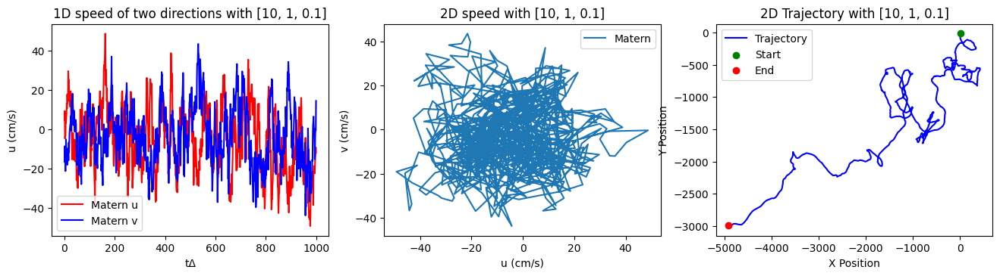

In [106]:
# Plotting
Fig3C = plt.figure(figsize=(16, 8))
a = np.max(XX)
b = np.min(XX)
c = max([a, -b])

# Subplot 1: Time series
plt.subplot(2, 3, 1)
plt.xlabel('tΔ')
plt.ylabel('u (cm/s)')
plt.plot(XX[:, 0], 'r', label='Matern u')
plt.plot(XX[:, 1], 'b', label='Matern v')
plt.legend()
plt.title(f"1D speed of two directions with {Q}")


# Subplot 2: Phase-space plot
plt.subplot(2, 3, 2)
plt.plot(XX[:, 0], XX[:, 1], label='Matern')
plt.xlabel('u (cm/s)')
plt.ylabel('v (cm/s)')
plt.legend()
plt.title(f"2D speed with {Q}")

# Subplot 2: Phase-space plot
plt.subplot(2, 3, 3)
u = XX[:,0]  # Example x-direction velocity
v = XX[:,1]  # Example y-direction velocity
x = np.cumsum(u) * 1  # Numerical integration (cumulative sum)
y = np.cumsum(v) * 1
plt.plot(x, y, label="Trajectory", color="b")
plt.scatter(x[0], y[0], color="g", label="Start", zorder=3)
plt.scatter(x[-1], y[-1], color="r", label="End", zorder=3)
plt.xlabel("X Position")
plt.ylabel("Y Position")
plt.title(f"2D Trajectory with {Q}")
plt.legend()

# Export figure
plt.show()

/var/folders/jv/kbv3tys55vsfc42p_y7b4rkw0000gn/T/ipykernel_44675/936182133.py:14: RuntimeWarning: divide by zero encountered in matmul
  XX = T @ Z
/var/folders/jv/kbv3tys55vsfc42p_y7b4rkw0000gn/T/ipykernel_44675/936182133.py:14: RuntimeWarning: overflow encountered in matmul
  XX = T @ Z
/var/folders/jv/kbv3tys55vsfc42p_y7b4rkw0000gn/T/ipykernel_44675/936182133.py:14: RuntimeWarning: invalid value encountered in matmul
  XX = T @ Z
/var/folders/jv/kbv3tys55vsfc42p_y7b4rkw0000gn/T/ipykernel_44675/936182133.py:35: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()
/var/folders/jv/kbv3tys55vsfc42p_y7b4rkw0000gn/T/ipykernel_44675/936182133.py:65: RuntimeWarning: divide by zero encountered in matmul
  XX = T @ Z
/var/folders/jv/kbv3tys55vsfc42p_y7b4rkw0000gn/T/ipykernel_44675/936182133.py:65: RuntimeWarning: overflow encountered in matmul
  XX = T @ Z
/var/f

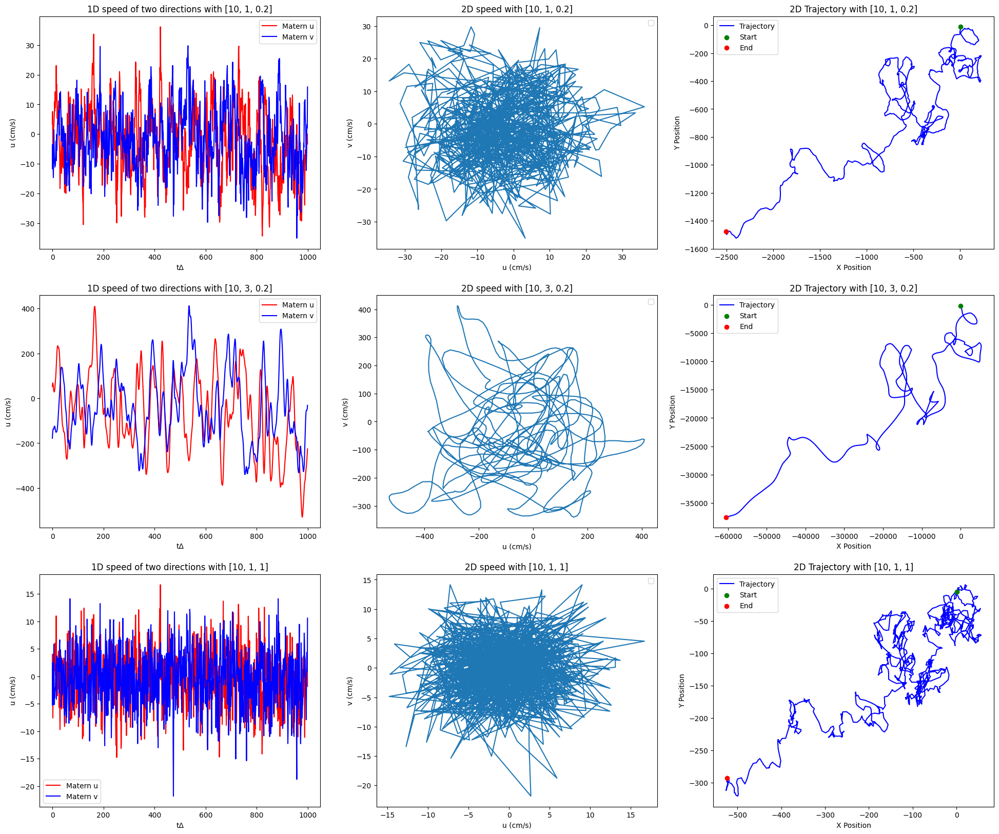

In [120]:
# Parameters
Q = [10, 1, 0.2]  # [B, α, h]
Delta = 1.0  # Time-step in hours
N = 1000  # Length of the time series
omega = np.arange(0, 2 * np.pi * (1 - 1/N)+1e-10, 2 * np.pi / N)
omega = np.fft.fftshift(omega)
omega[:N//2] -= 2 * np.pi

# Generating Matern time series
tpz = LTD.maternacvs(Q, N, Delta)
T = cholesky(toeplitz(tpz)).T  # Transpose for lower triangular
rng = np.random.default_rng(42)  # Set random seed for reproducibility
Z = rng.standard_normal((N, 2))  # Random Gaussian noise
XX = T @ Z
XX = XX / np.sqrt(2)  # Normalize to get the correct variance

# Plotting
Fig3C = plt.figure(figsize=(24, 20))
a = np.max(XX)
b = np.min(XX)
c = max([a, -b])

plt.subplot(3, 3, 1)
plt.xlabel('tΔ')
plt.ylabel('u (cm/s)')
plt.plot(XX[:, 0], 'r', label='Matern u')
plt.plot(XX[:, 1], 'b', label='Matern v')
plt.legend()
plt.title(f"1D speed of two directions with {Q}")

plt.subplot(3, 3, 2)
plt.plot(XX[:, 0], XX[:, 1])
plt.xlabel('u (cm/s)')
plt.ylabel('v (cm/s)')
plt.legend()
plt.title(f"2D speed with {Q}")

plt.subplot(3, 3, 3)
u = XX[:,0]  # Example x-direction velocity
v = XX[:,1]  # Example y-direction velocity
x = np.cumsum(u) * 1  # Numerical integration (cumulative sum)
y = np.cumsum(v) * 1
plt.plot(x, y, label="Trajectory", color="b")
plt.scatter(x[0], y[0], color="g", label="Start", zorder=3)
plt.scatter(x[-1], y[-1], color="r", label="End", zorder=3)
plt.xlabel("X Position")
plt.ylabel("Y Position")
plt.title(f"2D Trajectory with {Q}")
plt.legend()

# Parameters
Q = [10, 3, 0.2]  # [B, α, h]
Delta = 1.0  # Time-step in hours
N = 1000  # Length of the time series
omega = np.arange(0, 2 * np.pi * (1 - 1/N)+1e-10, 2 * np.pi / N)
omega = np.fft.fftshift(omega)
omega[:N//2] -= 2 * np.pi


# Generating Matern time series
tpz = LTD.maternacvs(Q, N, Delta)
T = cholesky(toeplitz(tpz)).T  # Transpose for lower triangular
rng = np.random.default_rng(42)  # Set random seed for reproducibility
Z = rng.standard_normal((N, 2))  # Random Gaussian noise
XX = T @ Z
XX = XX / np.sqrt(2)  # Normalize to get the correct variance

plt.subplot(3, 3, 4)
plt.xlabel('tΔ')
plt.ylabel('u (cm/s)')
plt.plot(XX[:, 0], 'r', label='Matern u')
plt.plot(XX[:, 1], 'b', label='Matern v')
plt.legend()
plt.title(f"1D speed of two directions with {Q}")

plt.subplot(3, 3, 5)
plt.plot(XX[:, 0], XX[:, 1])
plt.xlabel('u (cm/s)')
plt.ylabel('v (cm/s)')
plt.legend()
plt.title(f"2D speed with {Q}")

plt.subplot(3, 3, 6)
u = XX[:,0]  # Example x-direction velocity
v = XX[:,1]  # Example y-direction velocity
x = np.cumsum(u) * 1  # Numerical integration (cumulative sum)
y = np.cumsum(v) * 1
plt.plot(x, y, label="Trajectory", color="b")
plt.scatter(x[0], y[0], color="g", label="Start", zorder=3)
plt.scatter(x[-1], y[-1], color="r", label="End", zorder=3)
plt.xlabel("X Position")
plt.ylabel("Y Position")
plt.title(f"2D Trajectory with {Q}")
plt.legend()


# Parameters
Q = [10, 1, 1]  # [B, α, h]
Delta = 1.0  # Time-step in hours
N = 1000  # Length of the time series
omega = np.arange(0, 2 * np.pi * (1 - 1/N)+1e-10, 2 * np.pi / N)
omega = np.fft.fftshift(omega)
omega[:N//2] -= 2 * np.pi


# Generating Matern time series
tpz = LTD.maternacvs(Q, N, Delta)
T = cholesky(toeplitz(tpz)).T  # Transpose for lower triangular
rng = np.random.default_rng(42)  # Set random seed for reproducibility
Z = rng.standard_normal((N, 2))  # Random Gaussian noise
XX = T @ Z
XX = XX / np.sqrt(2)  # Normalize to get the correct variance

plt.subplot(3, 3, 7)
plt.xlabel('tΔ')
plt.ylabel('u (cm/s)')
plt.plot(XX[:, 0], 'r', label='Matern u')
plt.plot(XX[:, 1], 'b', label='Matern v')
plt.legend()
plt.title(f"1D speed of two directions with {Q}")

plt.subplot(3, 3, 8)
plt.plot(XX[:, 0], XX[:, 1])
plt.xlabel('u (cm/s)')
plt.ylabel('v (cm/s)')
plt.legend()
plt.title(f"2D speed with {Q}")

plt.subplot(3, 3, 9)
u = XX[:,0]  # Example x-direction velocity
v = XX[:,1]  # Example y-direction velocity
x = np.cumsum(u) * 1  # Numerical integration (cumulative sum)
y = np.cumsum(v) * 1
plt.plot(x, y, label="Trajectory", color="b")
plt.scatter(x[0], y[0], color="g", label="Start", zorder=3)
plt.scatter(x[-1], y[-1], color="r", label="End", zorder=3)
plt.xlabel("X Position")
plt.ylabel("Y Position")
plt.title(f"2D Trajectory with {Q}")
plt.legend()


In [ ]:
import numpy as np

def generate_complex_ou(A, c, Delta, N, seed=None):
    """
    Generate a length-N sample of a complex OU process with
      S(ω) = B^2 / (ω^2 + h^2),
    time-step Δ, decay rate h, amplitude B.
    """
    # AR‐coefficient
    phi = np.exp(-c * Delta)
    # stationary variance of each real & imag part: Var[X] = B^2/(2h)
    var0 = A**2 / (2 * c)
    # innovation standard deviation so that Var[X] stays var0:
    #   var0 = phi^2 var0 + 2*(σ_eta^2/2)  ⇒  σ_eta^2 = var0*(1 - phi^2)
    sigma_eta = np.sqrt(var0 * (1 - phi**2))
    
    rng = np.random.default_rng(seed)
    X = np.empty(N, dtype=np.complex128)
    # initialize at stationarity
    X[0] = (rng.normal(scale=np.sqrt(var0)) +
            1j * rng.normal(scale=np.sqrt(var0)))
    
    for n in range(N-1):
        # complex Gaussian noise with total var = sigma_eta^2
        # real & imag each var = sigma_eta^2/2
        noise = (rng.normal(scale=sigma_eta/np.sqrt(2)) +
                 1j * rng.normal(scale=sigma_eta/np.sqrt(2)))
        X[n+1] = phi * X[n] + noise
    
    return X

# Example usage


/var/folders/jv/kbv3tys55vsfc42p_y7b4rkw0000gn/T/ipykernel_44675/2142289819.py:23: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()
/var/folders/jv/kbv3tys55vsfc42p_y7b4rkw0000gn/T/ipykernel_44675/2142289819.py:60: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


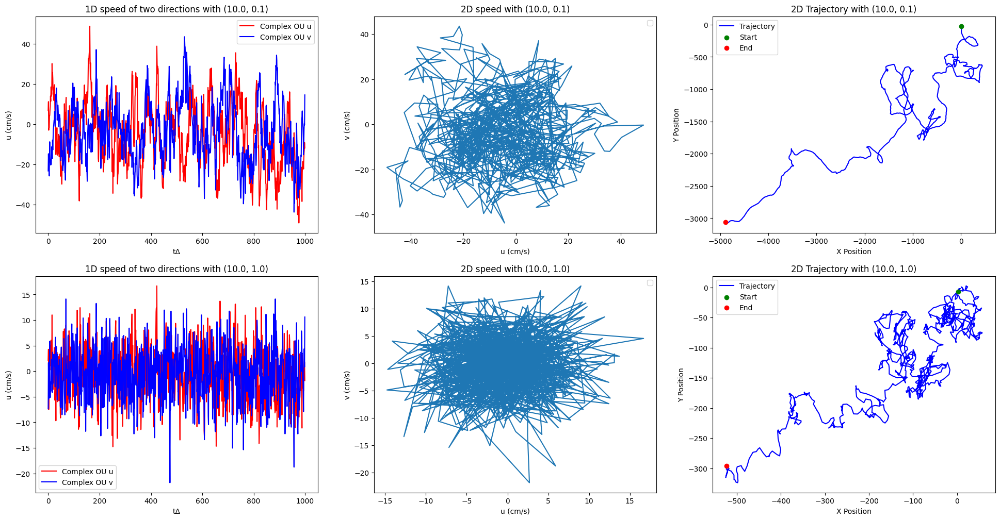

In [148]:
Fig3C = plt.figure(figsize=(24, 12))
A = 10.0      # amplitude
c_val = 0.1       # damping rate
Delta = 1.0   # time‐step
N = 1000      # length of series
X = generate_complex_ou(A, c_val, Delta, N, seed=42)
a = np.max(X)
b = np.min(X)
c = max([a, -b])

plt.subplot(2, 3, 1)
plt.xlabel('tΔ')
plt.ylabel('u (cm/s)')
plt.plot(X.real, 'r', label='Complex OU u')
plt.plot(X.imag, 'b', label='Complex OU v')
plt.legend()
plt.title(f"1D speed of two directions with {A, c_val}")

plt.subplot(2, 3, 2)
plt.plot(X.real, X.imag)
plt.xlabel('u (cm/s)')
plt.ylabel('v (cm/s)')
plt.legend()
plt.title(f"2D speed with {A, c_val}")

plt.subplot(2, 3, 3)
u = X.real  # Example x-direction velocity
v = X.imag  # Example y-direction velocity
x = np.cumsum(u) * 1  # Numerical integration (cumulative sum)
y = np.cumsum(v) * 1
plt.plot(x, y, label="Trajectory", color="b")
plt.scatter(x[0], y[0], color="g", label="Start", zorder=3)
plt.scatter(x[-1], y[-1], color="r", label="End", zorder=3)
plt.xlabel("X Position")
plt.ylabel("Y Position")
plt.title(f"2D Trajectory with {A, c_val}")
plt.legend()

A = 10.0      # amplitude
c_val = 1.0       # damping rate
Delta = 1.0   # time‐step
N = 1000      # length of series
X = generate_complex_ou(A, c_val, Delta, N, seed=42)
a = np.max(X)
b = np.min(X)
c = max([a, -b])

plt.subplot(2, 3, 4)
plt.xlabel('tΔ')
plt.ylabel('u (cm/s)')
plt.plot(X.real, 'r', label='Complex OU u')
plt.plot(X.imag, 'b', label='Complex OU v')
plt.legend()
plt.title(f"1D speed of two directions with {A, c_val}")

plt.subplot(2, 3, 5)
plt.plot(X.real, X.imag)
plt.xlabel('u (cm/s)')
plt.ylabel('v (cm/s)')
plt.legend()
plt.title(f"2D speed with {A, c_val}")

plt.subplot(2, 3, 6)
u = X.real  # Example x-direction velocity
v = X.imag  # Example y-direction velocity
x = np.cumsum(u) * 1  # Numerical integration (cumulative sum)
y = np.cumsum(v) * 1
plt.plot(x, y, label="Trajectory", color="b")
plt.scatter(x[0], y[0], color="g", label="Start", zorder=3)
plt.scatter(x[-1], y[-1], color="r", label="End", zorder=3)
plt.xlabel("X Position")
plt.ylabel("Y Position")
plt.title(f"2D Trajectory with {A, c_val}")
plt.legend()

In [ ]:
def simulate_timevarying_gaussian(mu_func, sigma_func, T, dt, seed=None):
    """
    Simulate X_t by Euler‐Maruyama so that
       X_t ~ N(mu(t), sigma(t)^2) for all t.
    
    SDE:  dX = mu'(t) dt + sqrt(d/dt[sigma^2(t)]) dW.
    """
    rng = np.random.default_rng(seed)
    N = int(np.round(T / dt))
    t = np.linspace(0, T, N+1)
    X = np.empty(N+1)
    
    # initialize exactly at the target marginal
    X[0] = mu_func(0)
    
    for n in range(N):
        tn = t[n]
        # compute derivatives by finite difference
        mup = mu_func(tn + dt)
        sigma2p = sigma_func(tn + dt)**2
        
        mu_dot = (mup - mu_func(tn)) / dt
        v_dot  = (sigma2p - sigma_func(tn)**2) / dt
        
        drift     = mu_dot
        # guard against tiny negative due to numerical error
        diffusion = np.sqrt(max(v_dot, 0.0))
        
        dW = rng.normal(scale=np.sqrt(dt))
        X[n+1] = X[n] + drift * dt + diffusion * dW
    
    return t, X

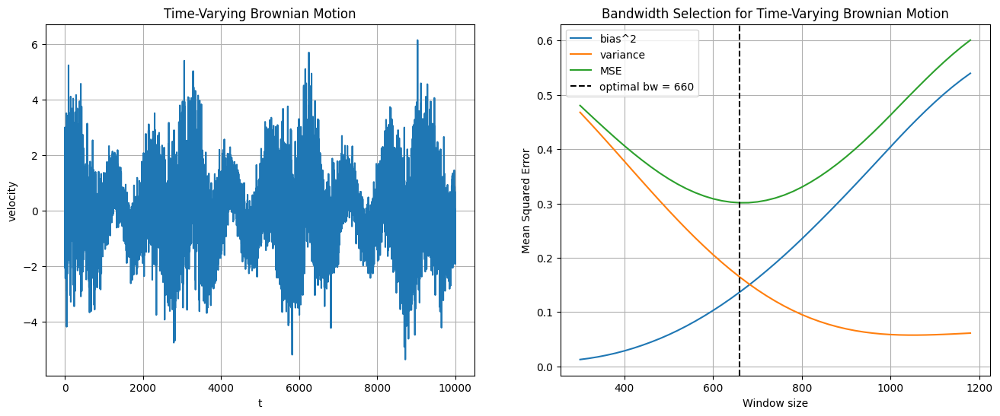

In [1029]:
#— 1) define your time‐varying μ and σ
mu_func    = lambda t: np.sin(2 * np.pi * t / 1000)      # example: slow sine‐wave mean
sigma_func = lambda t: 1 + 0.5*np.cos(2*np.pi*t/3000) # example: modulated stddev

#— 2) simulate a long realization at fine dt=1
T = 10000
dt = 1.0
t_full = np.arange(T) * dt
rng = np.random.default_rng(15463)
X = np.array([rng.normal(loc=mu_func(t), scale=sigma_func(t))
              for t in t_full])
              
plt.figure(figsize=(16, 6))
plt.subplot(1,2,1)
plt.plot(X)
plt.xlabel('t')
plt.ylabel('velocity')
plt.grid()
plt.title("Time-Varying Brownian Motion")
#— 3) sweep over candidate window‐sizes, compute MSE of μ̂ and σ̂
bandwidths = np.arange(300, 1200, 20)
bias2_list    = []
var_list = []
mse_list   = []

for bw in bandwidths:
    segments = [X[i:i + bw] for i in range(0, len(X) - bw)]
    local_mu = []
    local_sig = []
    true_mu = []
    true_sig = []

    for t, segment in enumerate(segments):
        t_mid   = (t + bw/2)

        # true parameters at window center
        mu_true = mu_func(t_mid)
        sigma_true = sigma_func(t_mid)
        true_mu.append(mu_true)
        true_sig.append(sigma_true)

        # local estimates
        mu_hat    = segment.mean()
        sigma_hat = segment.std(ddof=1)
        local_mu.append(mu_hat)
        local_sig.append(sigma_hat)
    
    bias = np.sum(np.abs(np.array(local_mu) - np.array(true_mu)))/(t+1)
    variance = np.var(local_mu) + np.var(local_sig)

    # average MSE over all windows
    bias2_list.append(bias**2)
    var_list.append(variance)

# find the bw minimizing the combined MSE
MSE_list = np.array(bias2_list) + np.array(var_list)
#— 4) (optional) plot results
# plt.plot(bandwidths, mse_mu_list,    label="MSE(μ̂)")
# plt.plot(bandwidths, mse_sig_list,   label="MSE(σ̂)")
plt.subplot(1, 2, 2)
plt.plot(bandwidths, bias2_list, label='bias^2')
plt.plot(bandwidths, var_list, label='variance')
plt.plot(bandwidths, MSE_list, label = 'MSE')
plt.axvline(bandwidths[np.argmin(MSE_list)], color="k", linestyle="--",
            label=f"optimal bw = {bandwidths[np.argmin(MSE_list)]}")
plt.xlabel("Window size")
plt.ylabel("Mean Squared Error")
plt.legend()
plt.title("Bandwidth Selection for Time-Varying Brownian Motion")
plt.grid()
plt.show()


In [437]:
def euler_maruyama(alpha_func, A_func, h_func, X0, T, dt):
    N = int(T / dt)
    t = np.linspace(0, T, N+1)
    X = np.zeros(N+1)
    X[0] = X0

    for n in range(N):
        alpha = alpha_func(t[n])
        A = A_func(t[n])
        h = h_func(t[n])
        dW = np.random.normal(loc=0.0, scale=np.sqrt(dt))
        X[n+1] = X[n] +  (-h * X[n] * dt) + (A * dW)

    return t, X

def complex_euler_maruyama(omega_func, c_func, A_func, X0, T, dt):
    N = int(T / dt)
    t = np.linspace(0, T, N+1)
    X = np.zeros(N+1, dtype=complex)
    X[0] = X0

    for n in range(N):
        # function values
        omega0 = omega_func(t[n])
        c = c_func(t[n])
        A = A_func(t[n])

        # complex value dQ
        dQ_r = np.random.normal(0, scale=np.sqrt(dt))
        dQ_i = np.random.normal(0, scale=np.sqrt(dt))
        dQ = (dQ_r + 1j * dQ_i) / np.sqrt(2)

        X[n+1] = X[n] + (1j * omega0 - c) * X[n] * dt + A * dQ

    return t, X

In [438]:
def local_periodogram(Y, Delta):
    N_seg = len(Y)
    Y = Y - np.mean(Y)
    SZ = (Delta / N_seg) * np.abs(np.fft.fft(Y))**2
    SZ = np.fft.fftshift(SZ)
    return SZ

def aggregate_spectral_density(f, omega0, c, A, B, alpha, h):
    return B**2 / ((f**2 + h**2)**1 + 1e-10) + A**2/ ((f - omega0)**2 + c**2 + 1e-10)

def aggregate_whittle_loss(params, periodogram, f):
    omega0, c, A, B, alpha, h = params
    model_spectrum = aggregate_spectral_density(f, omega0, c, A, B, 1, h)
    return np.sum(np.log(model_spectrum + 1e-10) + periodogram / (model_spectrum + 1e-10))

In [439]:
def alpha_func(t):
    return 1

def omega_func(t):
    return 1

def A_func(t):
    return 10

def B_func(t):
    return 15

def c_func(t):
    return 0.1

def h_func(t):
    return 0.1


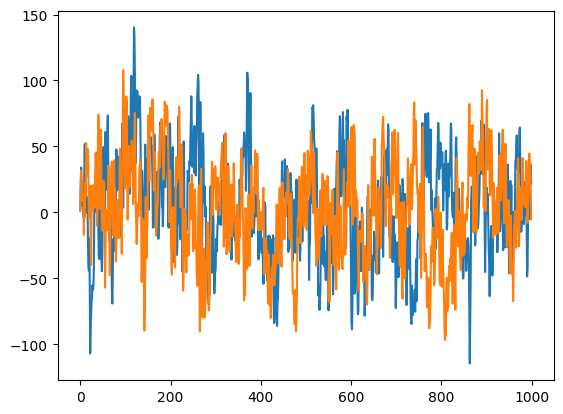

In [440]:
np.random.seed(2345)
X0 = 1.0  # Initial condition
T = 1000.0  # Total simulation time
dt = 0.01  # Time step
t, X1 = euler_maruyama(alpha_func, B_func, h_func, X0, T, dt)
t, X3 = euler_maruyama(alpha_func, B_func, h_func, X0, T, dt)
X1 = X1 + 1j*X3
t, X2 = complex_euler_maruyama(omega_func, c_func, A_func, X0, T, dt)
X = X1 + X2
X = np.array([X[100*i] for i in range(int(T))])
plt.plot(X.real)
plt.plot(X.imag)

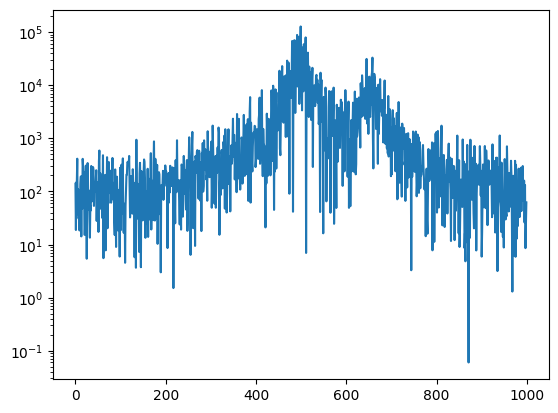

In [441]:
periodogram = (dt*100 / T) * np.abs(np.fft.fft(X))**2
periodogram = np.fft.fftshift(periodogram)
plt.plot(periodogram)
plt.yscale('log')

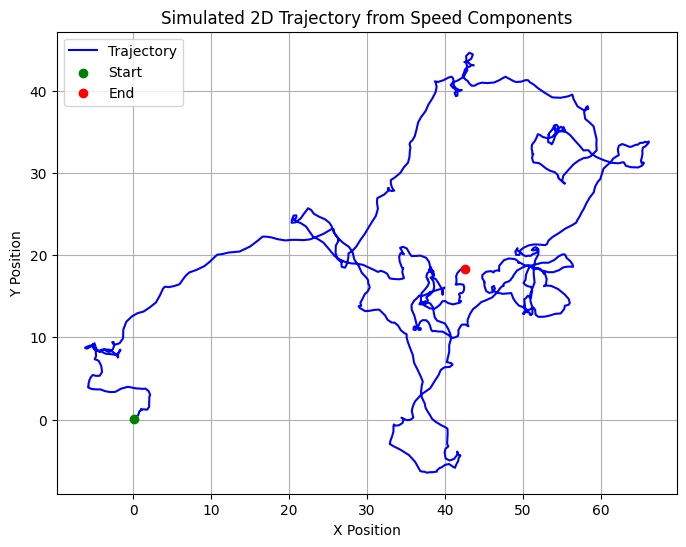

In [442]:
# Define u and v as some example speed components
u = X.real  # Example x-direction velocity
v = X.imag  # Example y-direction velocity

# Compute positions by integrating u and v
x = np.cumsum(u) * dt  # Numerical integration (cumulative sum)
y = np.cumsum(v) * dt

# Plot the trajectory
plt.figure(figsize=(8, 6))
plt.plot(x, y, label="Trajectory", color="b")
plt.scatter(x[0], y[0], color="g", label="Start", zorder=3)
plt.scatter(x[-1], y[-1], color="r", label="End", zorder=3)
plt.xlabel("X Position")
plt.ylabel("Y Position")
plt.title("Simulated 2D Trajectory from Speed Components")
plt.legend()
plt.grid()
plt.show()

In [443]:
A, omega, c, B, alpha, h = LTD.MaternOUFit(X, 0.5, 1, 1, 1, 1)

/Users/syx/Desktop/Imperial College London UG/Year4/MATH70050 M4R/Lagrangian Time Series Models for Ocean Surface Drifter Trajectories/Lagrangian_TSM_Drifter/maternOU.py:277: RuntimeWarning: divide by zero encountered in divide
  xb[5] = np.sqrt(np.median(SZ[np.r_[MF - NF - 1:MF - 1, MF:MF + NF]] *
/Users/syx/Desktop/Imperial College London UG/Year4/MATH70050 M4R/Lagrangian Time Series Models for Ocean Surface Drifter Trajectories/Lagrangian_TSM_Drifter/maternOU.py:155: OptimizeWarning: Unknown solver options: tol
  result = minimize(transformed_fun, x0u, method="Nelder-Mead", options=options)


Text(0.5, 1.0, 'Aggregate model fit for simulated data')

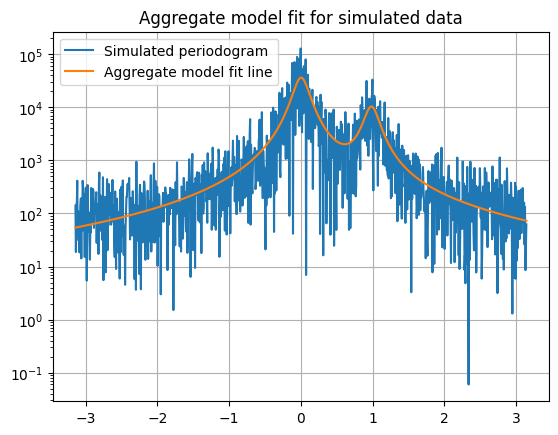

In [444]:
freqs = np.fft.fftshift(np.fft.fftfreq(len(X), d=1.0))
freqs *= 2 * np.pi
model_spectrum = aggregate_spectral_density(freqs, omega, c, A, B, 1, h)
xaxis = np.linspace(-np.pi, np.pi, 1000)

plt.plot(xaxis, periodogram, label='Simulated periodogram')
plt.plot(xaxis, model_spectrum, label='Aggregate model fit line')
plt.yscale('log')
plt.grid()
plt.legend()
plt.title('Aggregate model fit for simulated data')

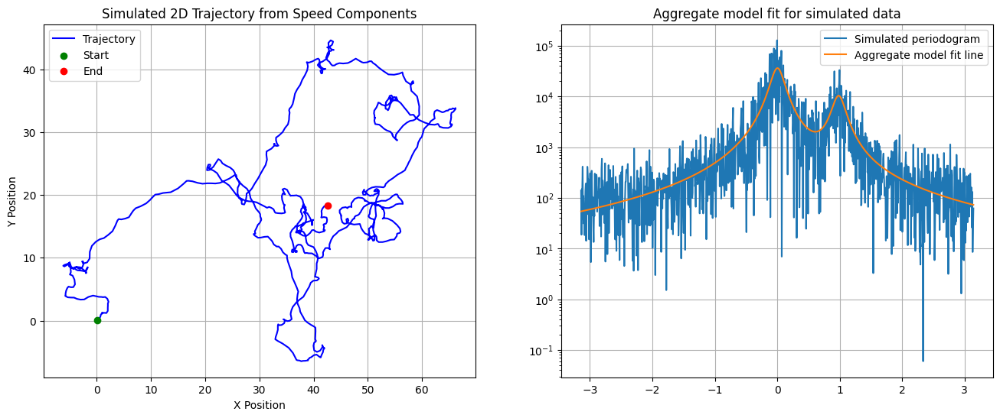

In [445]:
plt.figure(figsize=(16, 6))
plt.subplot(1, 2, 1)
plt.plot(x, y, label="Trajectory", color="b")
plt.scatter(x[0], y[0], color="g", label="Start", zorder=3)
plt.scatter(x[-1], y[-1], color="r", label="End", zorder=3)
plt.xlabel("X Position")
plt.ylabel("Y Position")
plt.title("Simulated 2D Trajectory from Speed Components")
plt.legend()
plt.grid()


plt.subplot(1, 2, 2)
plt.plot(xaxis, periodogram, label='Simulated periodogram')
plt.plot(xaxis, model_spectrum, label='Aggregate model fit line')
plt.yscale('log')
plt.grid()
plt.legend()
plt.title('Aggregate model fit for simulated data')

plt.show()

In [554]:
def alpha_func(t):
    return 1

def A_func(t):
    return 0.0005 * t + 10

def h_func(t):
    return 0.009
np.random.seed(2100)
X0 = 0.0  # Initial condition
T = 10000.0  # Total simulation time
dt = 1.0  # Time step

t, X = euler_maruyama(alpha_func, A_func, h_func, X0, T, dt)

In [555]:
def local_periodogram(Y, Delta):
    N_seg = len(Y)
    Y = Y - np.mean(Y)
    SZ = (Delta / N_seg) * np.abs(np.fft.fft(Y))**2
    SZ = np.fft.fftshift(SZ)
    return SZ

def matern_spectral_density(f, B, alpha, h):
    return B ** 2 / ((f**2 + h**2)**alpha + 1e-8)

def whittle_loss(params, periodogram, f):
    B, alpha, h = params
    model_spectrum = matern_spectral_density(f, B, alpha, h)
    return np.sum(np.log(model_spectrum + 1e-10) + periodogram / (model_spectrum + 1e-10))

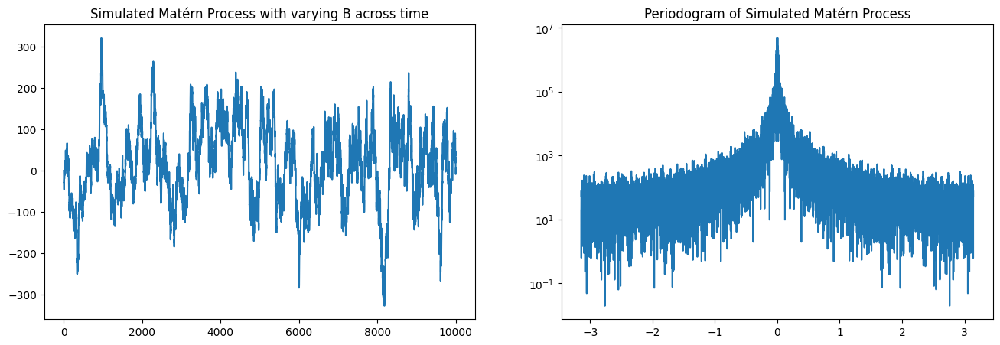

In [556]:
plt.figure(figsize=(16, 5))


plt.subplot(1, 2, 1)
plt.plot(X)
plt.title('Simulated Matérn Process with varying B across time')

plt.subplot(1, 2, 2)
periodogram = (dt / T) * np.abs(np.fft.fft(X))**2
periodogram = np.fft.fftshift(periodogram)
freqs = np.fft.fftshift(np.fft.fftfreq(len(periodogram), d=Delta))
freqs *= 2 * np.pi
plt.plot(freqs, periodogram)
plt.yscale('log')
plt.title('Periodogram of Simulated Matérn Process')

plt.show()


In [559]:
bandwidths = np.arange(1000, 10000, 100)
mse_list = []
mse_para_list = []
mse_A_list = []
mse_h_list = []
relative_A_list = []
relative_h_list = []
relative_list = []
for bw in bandwidths:
    segments = [X[i:i + bw] for i in range(0, 10000 - bw)]
    total_loss = 0
    total_para_losss = 0
    total_relative_A = 0
    total_relative_h = 0
    total_relative = 0
    total_A = 0
    total_h = 0
    
    for (t, segment) in enumerate(segments):
        segment -= np.mean(segment)
        periodogram = local_periodogram(segment, Delta)
        freqs = np.fft.fftshift(np.fft.fftfreq(len(segment), d=Delta))
        freqs *= 2 * np.pi
        A_true = A_func(t + len(segment) / 2)
        h_true = h_func(t + len(segment) / 2)

        # Initial guesses for parameters
        initial_params = [1.0, 1.0]
        bounds = [(0, None), (0, None)]
        def objective(para):
            A, h = para
            return whittle_loss(params=(A, 1, h), periodogram=periodogram, f=freqs)
        
        result = minimize(objective, initial_params, bounds=bounds)

        if result.success:
            A, h = result.x
            model_spectrum = matern_spectral_density(freqs, A, 1, h)
            mse = np.mean((periodogram - model_spectrum)**2) / len(periodogram)
            # mse = np.mean((periodogram/np.linalg.norm(periodogram) - model_spectrum/np.linalg.norm(periodogram))**2)
            mse_para = ((A - A_true)**2 + (h - h_true)**2) / 2
            mse_A = (A - A_true)**2
            mse_h = (h - h_true)**2
            relative_A = (A - A_true)/ A_true
            relative_h = (h - h_true) / h_true
            relative = (relative_A + relative_h) / 2
            total_loss += mse
            total_para_losss += mse_para
            total_A += mse_A
            total_h += mse_h
            total_relative_A += relative_A
            total_relative_h += relative_h
            total_relative += relative
            # print(result.x, A_true, h_true, mse_para, bw)


    avg_mse = total_loss / len(segments)
    avg_mse_para = total_para_losss / len(segments)
    mse_list.append(avg_mse)
    mse_para_list.append(avg_mse_para)
    mse_A_list.append(total_A / len(segments))
    mse_h_list.append(total_h / len(segments))
    relative_A_list.append(total_relative_A / len(segments))
    relative_h_list.append(total_relative_h / len(segments))
    relative_list.append(total_relative / len(segments))
    print(f"bw={bw} finishied")

optimal_bw = bandwidths[np.argmin(mse_para_list)]
print(f"Optimal Bandwidth: {optimal_bw}")

bw=1000 finishied
bw=1100 finishied
bw=1200 finishied
bw=1300 finishied
bw=1400 finishied
bw=1500 finishied
bw=1600 finishied
bw=1700 finishied
bw=1800 finishied
bw=1900 finishied
bw=2000 finishied
bw=2100 finishied
bw=2200 finishied
bw=2300 finishied
bw=2400 finishied
bw=2500 finishied
bw=2600 finishied
bw=2700 finishied
bw=2800 finishied
bw=2900 finishied
bw=3000 finishied
bw=3100 finishied
bw=3200 finishied
bw=3300 finishied
bw=3400 finishied
bw=3500 finishied
bw=3600 finishied
bw=3700 finishied
bw=3800 finishied
bw=3900 finishied
bw=4000 finishied
bw=4100 finishied
bw=4200 finishied
bw=4300 finishied
bw=4400 finishied
bw=4500 finishied
bw=4600 finishied
bw=4700 finishied
bw=4800 finishied
bw=4900 finishied
bw=5000 finishied
bw=5100 finishied
bw=5200 finishied
bw=5300 finishied
bw=5400 finishied
bw=5500 finishied
bw=5600 finishied
bw=5700 finishied
bw=5800 finishied
bw=5900 finishied
bw=6000 finishied
bw=6100 finishied
bw=6200 finishied
bw=6300 finishied
bw=6400 finishied
bw=6500 fi

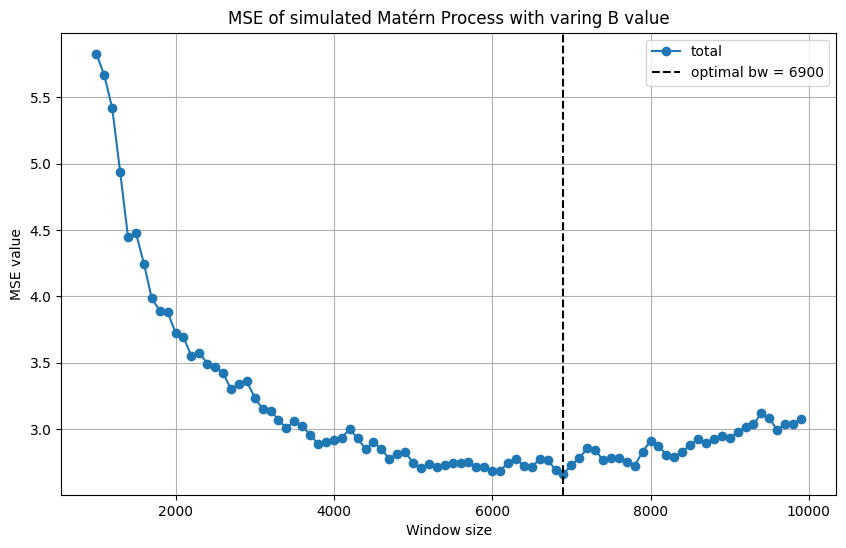

In [560]:
plt.figure(figsize=(10, 6))
plt.plot(bandwidths, np.array(mse_para_list), marker='o', label='total')
# plt.plot(bandwidths, mse_A_list, marker='o', label='A')
# plt.plot(bandwidths, mse_h_list, marker='o', label='h')
plt.axvline(optimal_bw, color="k", linestyle="--",
            label=f"optimal bw = {optimal_bw}")
plt.ylabel('MSE value')
plt.xlabel('Window size')
plt.title("MSE of simulated Matérn Process with varing B value")
plt.legend()
plt.grid()


In [1038]:
def omega_func(t):
    # return 0.5 * np.sin(t/1600)**2
    return 0.25

def c_func(t):
    # return 0.02 + 0.01 * np.sin(t/ 1000)
    return 0.02

def A_func(t):
    return 4 + 3 * np.sin(t/500)*np.cos(t/2400)

def complexOU_spectral_density(f, omega0, c, A):
    return A ** 2/ ((f - omega0)**2 + c**2 + 1e-8)

def complexOU_whittle_loss(params, periodogram, f):
    omega0, c, A = params
    model_spectrum = complexOU_spectral_density(f, omega0, c, A)
    return np.sum(np.log(model_spectrum + 1e-10) + periodogram / (model_spectrum + 1e-10))

In [1043]:
np.random.seed(23241)
X0 = 0.0 + 0.0j  # Initial condition
T = 10000.0  # Total simulation time
dt = 0.05  # Time step
t, X = complex_euler_maruyama(omega_func, c_func, A_func, X0, T, dt)

X = np.array([X[20*i] for i in range(int(T))])

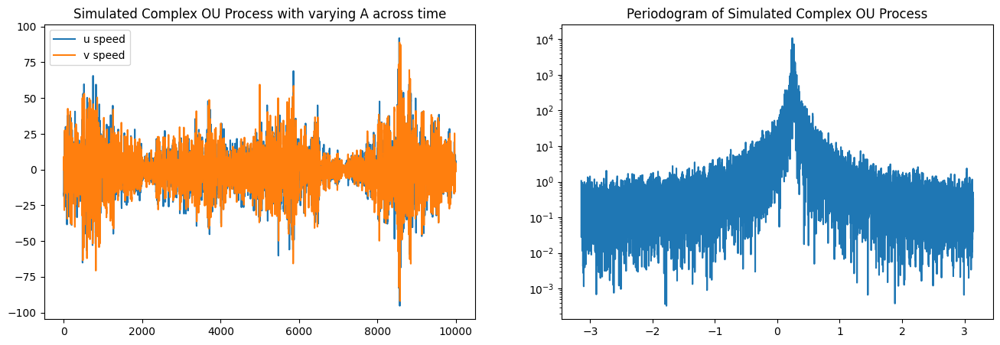

In [1044]:
plt.figure(figsize=(16, 5))
plt.subplot(1, 2, 1)
plt.plot(X.real, label='u speed')
plt.plot(X.imag, label='v speed')
plt.legend()
plt.title('Simulated Complex OU Process with varying A across time')

plt.subplot(1, 2, 2)
periodogram = (dt / T) * np.abs(np.fft.fft(X))**2
periodogram = np.fft.fftshift(periodogram)
freqs = np.fft.fftshift(np.fft.fftfreq(len(periodogram), d=Delta))
freqs *= 2 * np.pi
plt.plot(freqs, periodogram)
plt.yscale('log')
plt.title('Periodogram of Simulated Complex OU Process')

plt.show()


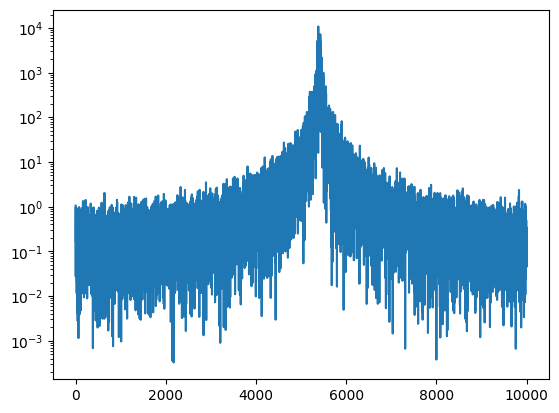

In [468]:
periodogram = (dt / T) * np.abs(np.fft.fft(X))**2
periodogram = np.fft.fftshift(periodogram)
plt.plot(periodogram)
plt.yscale('log')

In [469]:
bandwidths = np.arange(100, 4000, 50)
mse_list = []
mse_para_list = []
mse_omega_list = []
mse_c_list = []
mse_A_list = []
relative_omega_list = []
relative_c_list = []
relative_A_list = []
relative_list = []
for bw in bandwidths:
    segments = [X[i:i + bw] for i in range(0, 10000 - bw)]
    total_loss = 0
    total_para_losss = 0
    total_relative_omega = 0
    total_relative_c = 0
    total_relative_A = 0
    total_relative = 0
    total_omega = 0
    total_c = 0
    total_A = 0
    
    for (t, segment) in enumerate(segments):
        # segment -= np.mean(segment)
        periodogram = local_periodogram(segment, Delta)
        freqs = np.fft.fftshift(np.fft.fftfreq(len(segment), d=Delta))
        freqs *= 2 * np.pi
        omega_true = omega_func(t + len(segment) / 2)
        c_true = c_func(t + len(segment) / 2)
        A_true = A_func(t + len(segment) / 2)

        # Initial guesses for parameters
        initial_params = [1.0, 1.0, 1.0]
        bounds = [(0, None), (0, None), (0, None)]
        def objective(para):
            omega, c, A = para
            return complexOU_whittle_loss(params=(omega, c, A), periodogram=periodogram, f=freqs)
        
        result = minimize(objective, initial_params, bounds=bounds)

        if result.success:
            omega, c, A = result.x
            model_spectrum = complexOU_spectral_density(freqs, omega, c, A)
            mse = np.mean((periodogram - model_spectrum)**2) / len(periodogram)
            # mse = np.mean((periodogram/np.linalg.norm(periodogram) - model_spectrum/np.linalg.norm(periodogram))**2)
            mse_para = ((omega - omega_true)**2 + (c - c_true)**2 + (A - A_true)**2) / 3
            mse_omega = (omega - omega_true)**2
            mse_c = (c - c_true)**2
            mse_A = (A - A_true)**2
            relative_omega = (omega - omega_true) / omega_true
            relative_c = (c - c_true) / c_true
            relative_A = (A - A_true)/ A_true
            relative = (relative_A + relative_c + relative_omega) / 3
            total_loss += mse
            total_para_losss += mse_para
            total_omega += mse_omega
            total_c += mse_c
            total_A += mse_A
            total_relative_omega += relative_omega
            total_relative_c += relative_c
            total_relative_A += relative_A
            total_relative += relative
            # print(result.x, A_true, h_true, mse_para, bw)


    avg_mse = total_loss / len(segments)
    avg_mse_para = total_para_losss / len(segments)
    mse_list.append(avg_mse)
    mse_para_list.append(avg_mse_para)
    mse_omega_list.append(total_omega / len(segments))
    mse_c_list.append(total_c / len(segments))
    mse_A_list.append(total_A / len(segments))
    relative_omega_list.append(total_relative_omega / len(segments))
    relative_c_list.append(total_relative_c / len(segments))
    relative_A_list.append(total_relative_A / len(segments))
    relative_list.append(total_relative / len(segments))
    print(f"bw={bw} finishied")

optimal_bw = bandwidths[np.argmin(mse_para_list)]
print(f"Optimal Bandwidth: {optimal_bw}")

bw=100 finishied
bw=150 finishied
bw=200 finishied
bw=250 finishied
bw=300 finishied
bw=350 finishied
bw=400 finishied
bw=450 finishied
bw=500 finishied
bw=550 finishied
bw=600 finishied
bw=650 finishied
bw=700 finishied
bw=750 finishied
bw=800 finishied
bw=850 finishied
bw=900 finishied
bw=950 finishied
bw=1000 finishied
bw=1050 finishied
bw=1100 finishied
bw=1150 finishied
bw=1200 finishied
bw=1250 finishied
bw=1300 finishied
bw=1350 finishied
bw=1400 finishied
bw=1450 finishied
bw=1500 finishied
bw=1550 finishied
bw=1600 finishied
bw=1650 finishied
bw=1700 finishied
bw=1750 finishied
bw=1800 finishied
bw=1850 finishied
bw=1900 finishied
bw=1950 finishied
bw=2000 finishied
bw=2050 finishied
bw=2100 finishied
bw=2150 finishied
bw=2200 finishied
bw=2250 finishied
bw=2300 finishied
bw=2350 finishied
bw=2400 finishied
bw=2450 finishied
bw=2500 finishied
bw=2550 finishied
bw=2600 finishied
bw=2650 finishied
bw=2700 finishied
bw=2750 finishied
bw=2800 finishied
bw=2850 finishied
bw=2900 fi

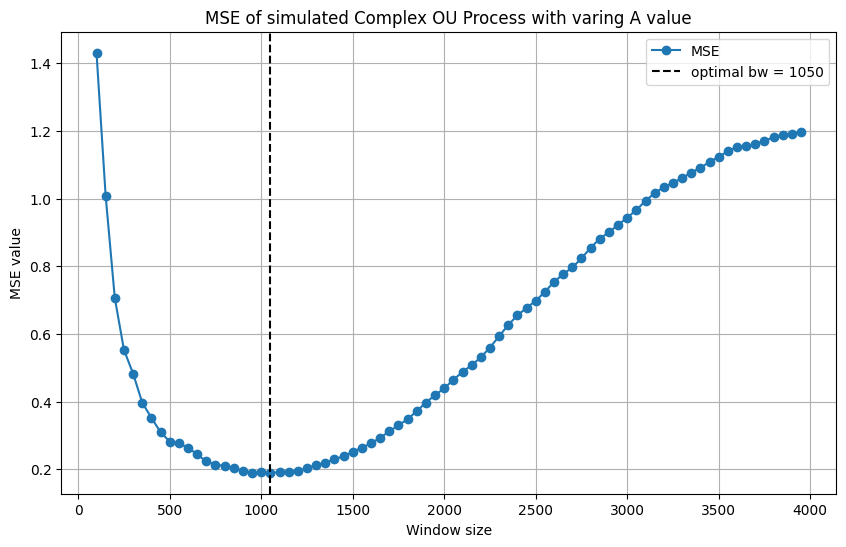

In [484]:
plt.figure(figsize=(10, 6))
plt.plot(bandwidths, np.array(mse_para_list), marker='o', label='MSE')
# plt.plot(bandwidths, mse_omega_list, marker='o', label='omega')
# plt.plot(bandwidths, mse_c_list, marker='o', label='c')
# plt.plot(bandwidths[10:], mse_A_list[10:], marker='o', label='A')
plt.axvline(optimal_bw, color="k", linestyle="--",
            label=f"optimal bw = {optimal_bw}")
plt.legend()
plt.ylabel('MSE value')
plt.xlabel('Window size')
plt.title("MSE of simulated Complex OU Process with varing A value")
plt.grid()

In [1062]:
def omega_func(t):
    return 0.5 + 0.1 * np.cos(t/1000)**2

def A_func(t):
    return 5 + 3 * np.cos(t/3000)

def B_func(t):
    return 20 + 5 * np.sin(t/1600)

def c_func(t):
    return 0.02 + 0.01 * np.cos(t / 1500)

def h_func(t):
    return 0.06 + 0.03 * np.sin(t/3000)


In [1063]:
np.random.seed(2345)
X0 = 1.0  # Initial condition
T = 10000.0  # Total simulation time
dt = 0.01  # Time step
t, X1 = euler_maruyama(alpha_func, B_func, h_func, X0, T, dt)
t, X3 = euler_maruyama(alpha_func, B_func, h_func, X0, T, dt)
X1 = X1 + 1j*X3
t, X2 = complex_euler_maruyama(omega_func, c_func, A_func, X0, T, dt)

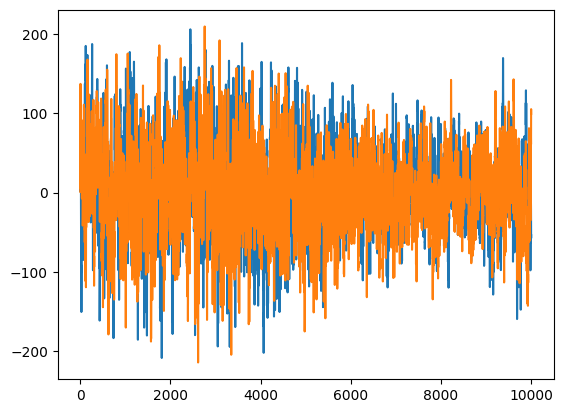

In [1064]:
X = X1 + X2
X = np.array([X[100*i] for i in range(int(T))])
plt.plot(X.real)
plt.plot(X.imag)

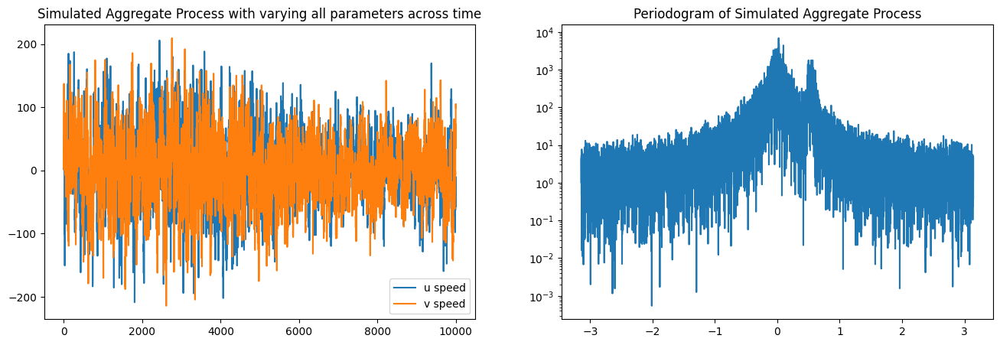

In [1065]:
plt.figure(figsize=(16, 5))
plt.subplot(1, 2, 1)
plt.plot(X.real, label='u speed')
plt.plot(X.imag, label='v speed')
plt.legend()
plt.title('Simulated Aggregate Process with varying all parameters across time')

plt.subplot(1, 2, 2)
periodogram = (dt / T) * np.abs(np.fft.fft(X))**2
periodogram = np.fft.fftshift(periodogram)
freqs = np.fft.fftshift(np.fft.fftfreq(len(periodogram), d=Delta))
freqs *= 2 * np.pi
plt.plot(freqs, periodogram)
plt.yscale('log')
plt.title('Periodogram of Simulated Aggregate Process')

plt.show()

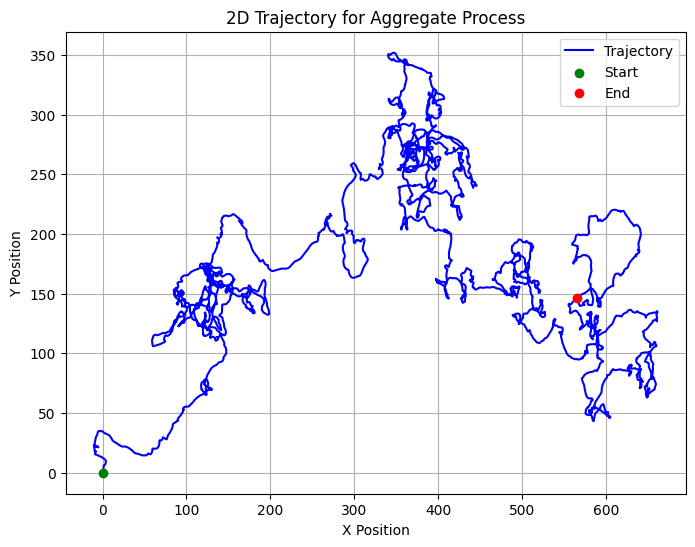

In [1066]:
# Define u and v as some example speed components
u = X.real  # Example x-direction velocity
v = X.imag  # Example y-direction velocity

# Compute positions by integrating u and v
x = np.cumsum(u) * dt  # Numerical integration (cumulative sum)
y = np.cumsum(v) * dt

# Plot the trajectory
plt.figure(figsize=(8, 6))
plt.plot(x, y, label="Trajectory", color="b")
plt.scatter(x[0], y[0], color="g", label="Start", zorder=3)
plt.scatter(x[-1], y[-1], color="r", label="End", zorder=3)
plt.xlabel("X Position")
plt.ylabel("Y Position")
plt.title("2D Trajectory for Aggregate Process")
plt.legend()
plt.grid()
plt.show()

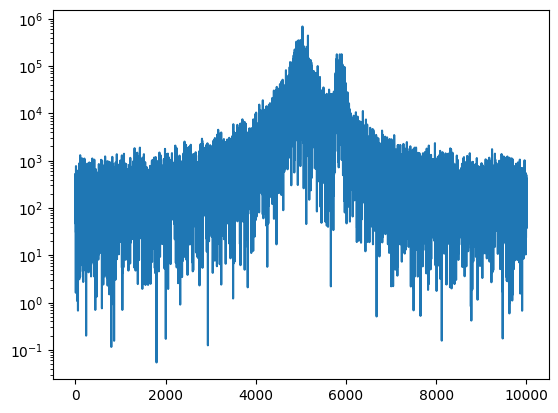

In [1067]:
periodogram = (dt*100 / T) * np.abs(np.fft.fft(X[0:10000]))**2
periodogram = np.fft.fftshift(periodogram)
plt.plot(periodogram)
plt.yscale('log')

In [1068]:
def aggregate_spectral_density(f, omega0, c, A, B, alpha, h):
    return B**2 / ((f**2 + h**2)**1 + 1e-10) + A**2/ ((f - omega0)**2 + c**2 + 1e-10)

def aggregate_whittle_loss(params, periodogram, f):
    omega0, c, A, B, alpha, h = params
    model_spectrum = aggregate_spectral_density(f, omega0, c, A, B, 1, h)
    return np.sum(np.log(model_spectrum + 1e-10) + periodogram / (model_spectrum + 1e-10))

In [1069]:
bandwidths = np.arange(300, 5000, 50)
mse_list = []
mse_para_list = []
mse_omega_list = []
mse_c_list = []
mse_A_list = []
mse_B_list = []
mse_h_list = []
relative_omega_list = []
relative_c_list = []
relative_A_list = []
relative_B_list = []
relative_h_list = []
relative_list = []

Delta = 1.0
for bw in bandwidths:
    segments = [X[i:i + bw] for i in range(0, 10000 - bw)]
    # segments = [X[i:i + bw] for i in range(0, 10000 - bw, 50)]

    total_loss = 0
    total_para_losss = 0
    total_relative_omega = 0
    total_relative_c = 0
    total_relative_A = 0
    total_relative_B = 0
    total_relative_h = 0
    total_relative = 0
    total_omega = 0
    total_c = 0
    total_A = 0
    total_B = 0
    total_h = 0
    count = 0
    
    for (t, segment) in enumerate(segments):
        segment -= np.mean(segment)
        periodogram = local_periodogram(segment, Delta)
        freqs = np.fft.fftshift(np.fft.fftfreq(len(segment), d=Delta))
        freqs *= 2 * np.pi
        omega_true = omega_func(t + len(segment) / 2)
        c_true = c_func(t + len(segment) / 2)
        A_true = A_func(t + len(segment) / 2)
        B_true = B_func(t + len(segment) / 2)
        h_true = h_func(t + len(segment) / 2)

        # Initial guesses for parameters
        initial_params = [1.0, 1.0, 1.0, 1.0, 1.0]
        bounds = [(0, None), (0, None), (0, None), (0, None), (0, None)]
        def objective(para):
            omega, c, A, B, h = para
            return aggregate_whittle_loss(params=(omega, c, A, B, 1, h), periodogram=periodogram, f=freqs)
        
        result = minimize(objective, initial_params, bounds=bounds,method='L-BFGS-B')
        # A, omega, c, B, alpha, h = LTD.MaternOUFit(segment, 0, 1, 1, 1, 0)


        # if sum(np.isnan((A, omega, c, B, h))) == 0 and np.max((A, omega, c, B, h)) < 1000:
        if result.success and sum(result.x) < 50:
            omega, c, A, B, h = result.x
            model_spectrum = aggregate_spectral_density(freqs, omega, c, A, B, 1, h)
            mse = np.mean((periodogram - model_spectrum)**2) / len(periodogram)
            # mse = np.mean((periodogram/np.linalg.norm(periodogram) - model_spectrum/np.linalg.norm(periodogram))**2)
            mse_para = ((omega - omega_true)**2 + (c - c_true)**2 + (A - A_true)**2
                        + (B - B_true)**2 + (h - h_true)**2) / 5
            mse_omega = (omega - omega_true)**2
            mse_c = (c - c_true)**2
            mse_A = (A - A_true)**2
            mse_B = (B - B_true)**2
            mse_h = (h - h_true)**2

            relative_omega = (omega - omega_true) / omega_true
            relative_c = (c - c_true) / c_true
            relative_A = (A - A_true)/ A_true
            relative_B = (B - B_true)/ B_true
            relative_h = (h - h_true)/ h_true
            relative = (relative_A + relative_h + relative_omega) / 5
            
            total_loss += mse
            total_para_losss += mse_para
            total_omega += mse_omega
            total_c += mse_c
            total_A += mse_A
            total_B += mse_B
            total_h += mse_h
            total_relative_omega += relative_omega
            total_relative_c += relative_c
            total_relative_A += relative_A
            total_relative_B += relative_B
            total_relative_h += relative_h
            total_relative += relative
            count += 1



    avg_mse = total_loss / count
    avg_mse_para = total_para_losss / count
    mse_list.append(avg_mse)
    mse_para_list.append(avg_mse_para)
    mse_omega_list.append(total_omega / count)
    mse_c_list.append(total_c / count)
    mse_A_list.append(total_A / count)
    mse_B_list.append(total_B / count)
    mse_h_list.append(total_h / count)
    relative_omega_list.append(total_relative_omega / count)
    relative_c_list.append(total_relative_c / count)
    relative_A_list.append(total_relative_A / count)
    relative_B_list.append(total_relative_B / count)
    relative_h_list.append(total_relative_h / count)
    relative_list.append(total_relative / count)
    print(f"bw={bw} finishied")

bw=300 finishied
bw=350 finishied
bw=400 finishied
bw=450 finishied
bw=500 finishied
bw=550 finishied
bw=600 finishied
bw=650 finishied
bw=700 finishied
bw=750 finishied
bw=800 finishied
bw=850 finishied
bw=900 finishied
bw=950 finishied
bw=1000 finishied
bw=1050 finishied
bw=1100 finishied
bw=1150 finishied
bw=1200 finishied
bw=1250 finishied
bw=1300 finishied
bw=1350 finishied
bw=1400 finishied
bw=1450 finishied
bw=1500 finishied
bw=1550 finishied
bw=1600 finishied
bw=1650 finishied
bw=1700 finishied
bw=1750 finishied
bw=1800 finishied
bw=1850 finishied
bw=1900 finishied
bw=1950 finishied
bw=2000 finishied
bw=2050 finishied
bw=2100 finishied
bw=2150 finishied
bw=2200 finishied
bw=2250 finishied
bw=2300 finishied
bw=2350 finishied
bw=2400 finishied
bw=2450 finishied
bw=2500 finishied
bw=2550 finishied
bw=2600 finishied
bw=2650 finishied
bw=2700 finishied
bw=2750 finishied
bw=2800 finishied
bw=2850 finishied
bw=2900 finishied
bw=2950 finishied
bw=3000 finishied
bw=3050 finishied
bw=310

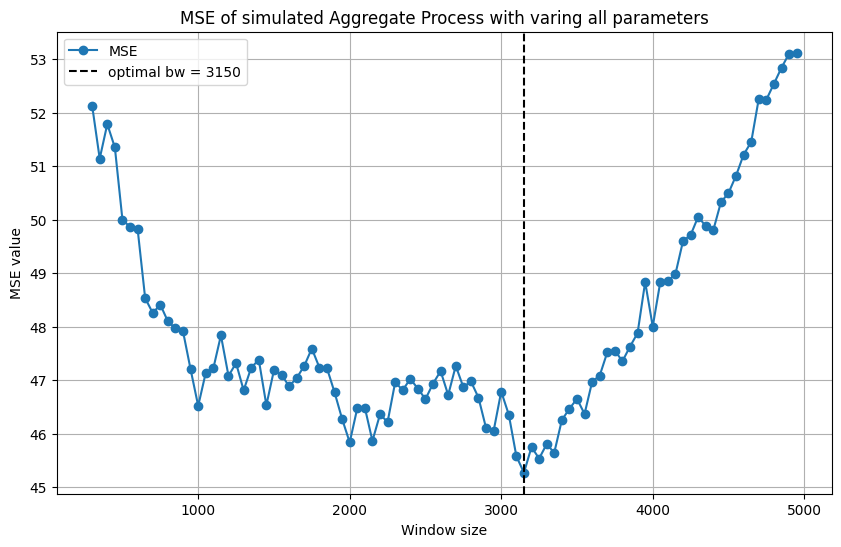

In [1070]:
optimal_bw = bandwidths[np.argmin(mse_para_list)]
plt.figure(figsize=(10, 6))
plt.plot(bandwidths, np.array(mse_para_list), marker='o', label='MSE')
# plt.plot(bandwidths, mse_omega_list, marker='o', label='omega')
# plt.plot(bandwidths, mse_c_list, marker='o', label='c')
# plt.plot(bandwidths[10:], mse_A_list[10:], marker='o', label='A')
plt.axvline(optimal_bw, color="k", linestyle="--",
            label=f"optimal bw = {optimal_bw}")
plt.legend()
plt.ylabel('MSE value')
plt.xlabel('Window size')
plt.title("MSE of simulated Aggregate Process with varing all parameters")
plt.grid()

In [1072]:
file_path = '/Users/syx/Desktop/Imperial College London UG/Year4/MATH70050 M4R/Lagrangian Time Series Models for Ocean Surface Drifter Trajectories/Ulysses6p.mat'
try:
    mat_data = scipy.io.loadmat(file_path)
    print("MAT file successfully loaded with scipy.io.loadmat")
    print(mat_data.keys())  # Print available variables
except Exception as e:
    print(f"Error loading MAT file: {e}")

MAT file successfully loaded with scipy.io.loadmat
dict_keys(['__header__', '__version__', '__globals__', 'Ulysses6p'])


In [1073]:
cf_values = mat_data['Ulysses6p']['cf'][0][0][0]
A_values = mat_data['Ulysses6p']['param'][0][0][:,0]
omega_values = mat_data['Ulysses6p']['param'][0][0][:,1]
c_values = mat_data['Ulysses6p']['param'][0][0][:,2]
B_values = mat_data['Ulysses6p']['param'][0][0][:,3]
alpha_values = mat_data['Ulysses6p']['param'][0][0][:,4]
h_values = mat_data['Ulysses6p']['param'][0][0][:,5]

In [1074]:
coeffs = np.polyfit(np.arange(len(omega_values)), omega_values, 15)
poly_omega = np.poly1d(coeffs)

coeffs = np.polyfit(np.arange(len(A_values)), A_values, 15)
poly_A = np.poly1d(coeffs)

coeffs = np.polyfit(np.arange(len(B_values)), B_values, 15)
poly_B = np.poly1d(coeffs)

coeffs = np.polyfit(np.arange(len(c_values)), c_values, 15)
poly_c = np.poly1d(coeffs)

coeffs = np.polyfit(np.arange(len(h_values)), h_values, 15)
poly_h = np.poly1d(coeffs)

def omega_func(t):
    return poly_omega(t)

def A_func(t):
    return poly_A(t)

def B_func(t):
    return poly_B(t)

def c_func(t):
    return poly_c(t)

def h_func(t):
    return poly_h(t)

def alpha_func(t):
    return 1

Text(0.5, 1.0, 'Interpolation to omega value')

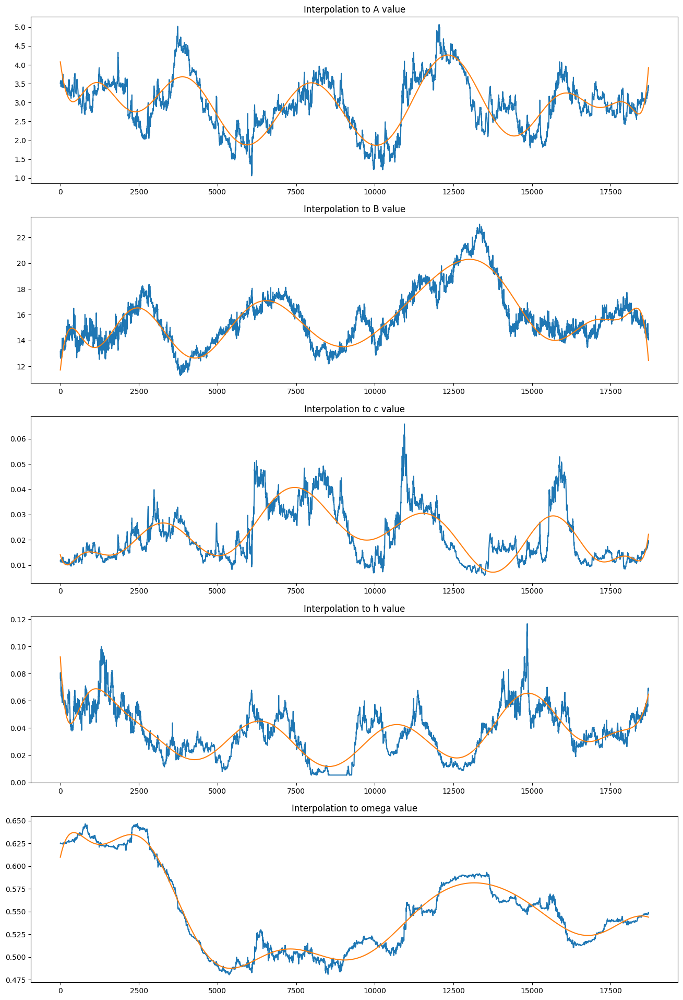

In [ ]:
plt.figure(figsize=(16, 24))

plt.subplot(5, 1, 1)
plt.plot(A_values)
plt.plot(A_func(np.arange(0, 18705, 1)))
plt.title('Interpolation to A value')

plt.subplot(5, 1, 2)
plt.plot(B_values)
plt.plot(B_func(np.arange(0, 18705, 1)))
plt.title('Interpolation to B value')

plt.subplot(5, 1, 3)
plt.plot(c_values)
plt.plot(c_func(np.arange(0, 18705, 1)))
plt.title('Interpolation to c value')

plt.subplot(5, 1, 4)
plt.plot(h_values)
plt.plot(h_func(np.arange(0, 18705, 1)))
plt.title('Interpolation to h value')

plt.subplot(5, 1, 5)
plt.plot(omega_values)
plt.plot(omega_func(np.arange(0, 18705, 1)))
plt.title('Interpolation to omega value')


In [921]:
def omega_func(t):
    return poly_omega(t)

def A_func(t):
    return poly_A(t)

def B_func(t):
    return poly_B(t)

def c_func(t):
    return poly_c(t)

def h_func(t):
    return poly_h(t)

In [1079]:
np.random.seed(2136347890)
X0 = 0
T = 6000.0
dt = 1/500
t, X1 = euler_maruyama(alpha_func, B_func, h_func, X0, T, dt)
t, X3 = euler_maruyama(alpha_func, B_func, h_func, X0, T, dt)
X1 = X1 + 1j*X3
t, X2 = complex_euler_maruyama(omega_func, c_func, A_func, X0+0j, T, dt)
X = X1 + X2
X = np.array([X[125*i] for i in range(int(4 * T))])


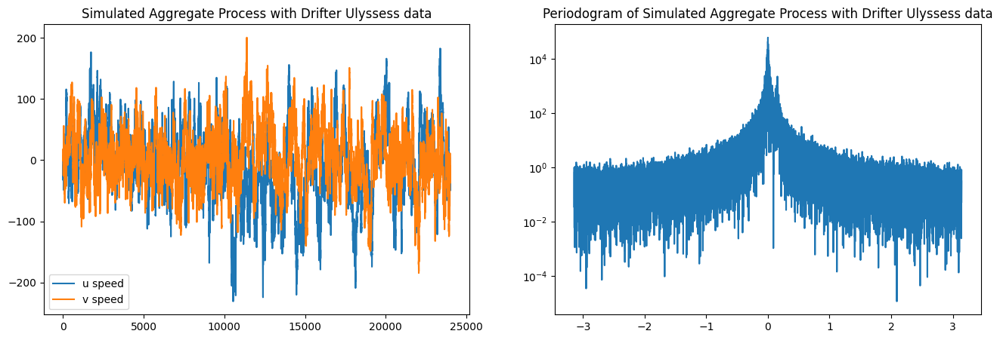

In [1091]:
plt.figure(figsize=(16, 5))
plt.subplot(1, 2, 1)
plt.plot(X.real, label='u speed')
plt.plot(X.imag, label='v speed')
plt.legend()
plt.title('Simulated Aggregate Process with Drifter Ulyssess data')

plt.subplot(1, 2, 2)
periodogram = (dt / T) * np.abs(np.fft.fft(X))**2
periodogram = np.fft.fftshift(periodogram)
freqs = np.fft.fftshift(np.fft.fftfreq(len(periodogram), d=Delta))
freqs *= 2 * np.pi
plt.plot(freqs, periodogram)
plt.yscale('log')
plt.title('Periodogram of Simulated Aggregate Process with Drifter Ulyssess data')


# plt.subplot(3, 1, 3)
# u = X.real  # Example x-direction velocity
# v = X.imag  # Example y-direction velocity

# # Compute positions by integrating u and v
# x = np.cumsum(u) * dt  # Numerical integration (cumulative sum)
# y = np.cumsum(v) * dt

# # Plot the trajectory
# plt.plot(x, y, label="Trajectory", color="b")
# plt.scatter(x[0], y[0], color="g", label="Start", zorder=3)
# plt.scatter(x[-1], y[-1], color="r", label="End", zorder=3)
# plt.xlabel("X Position")
# plt.ylabel("Y Position")
# plt.title("2D Trajectory from Speed Components")
# plt.legend()
# plt.grid()

plt.show()

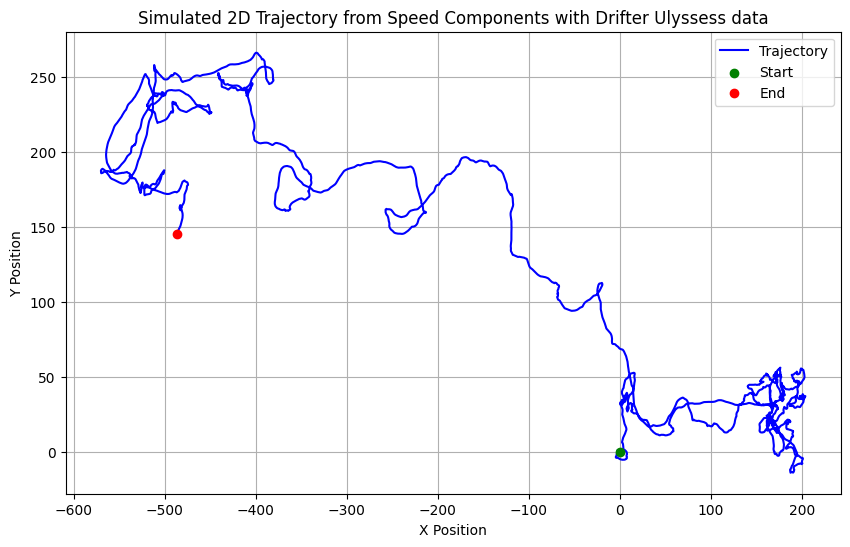

In [1093]:
import numpy as np
import matplotlib.pyplot as plt

# Define u and v as some example speed components
u = X.real  # Example x-direction velocity
v = X.imag  # Example y-direction velocity

# Compute positions by integrating u and v
x = np.cumsum(u) * dt  # Numerical integration (cumulative sum)
y = np.cumsum(v) * dt

# Plot the trajectory
plt.figure(figsize=(10, 6))
plt.plot(x, y, label="Trajectory", color="b")
plt.scatter(x[0], y[0], color="g", label="Start", zorder=3)
plt.scatter(x[-1], y[-1], color="r", label="End", zorder=3)
plt.xlabel("X Position")
plt.ylabel("Y Position")
plt.title("Simulated 2D Trajectory from Speed Components with Drifter Ulyssess data")
plt.legend()
plt.grid()
plt.show()

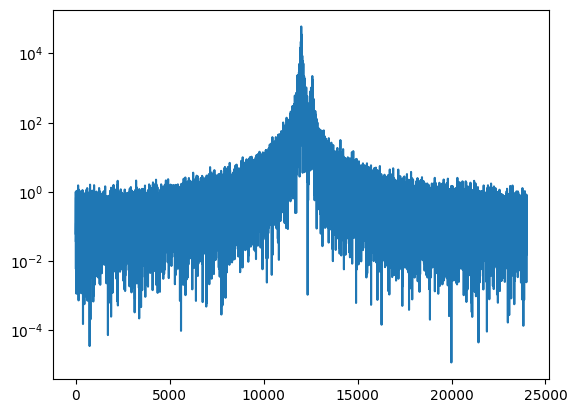

In [925]:
periodogram = (dt / T) * np.abs(np.fft.fft(X))**2
periodogram = np.fft.fftshift(periodogram)
plt.plot(periodogram)
plt.yscale('log')

In [926]:
bandwidths = np.arange(300, 4000, 100)
mse_list = []
mse_para_list = []
mse_omega_list = []
mse_c_list = []
mse_A_list = []
mse_B_list = []
mse_h_list = []
relative_omega_list = []
relative_c_list = []
relative_A_list = []
relative_B_list = []
relative_h_list = []
relative_list = []

Delta = 1.0

for bw in bandwidths:
    # if bw <= 500:
    #     segments = [X[i:i + bw] for i in range(0, len(X) - bw, 150)]
    # elif 500 < bw < 1000:
    #     segments = [X[i:i + bw] for i in range(0, len(X) - bw, 150)]
    # else:
    #     segments = [X[i:i + bw] for i in range(0, len(X) - bw, 150)]
    segments = [X[i:i + bw] for i in range(0, len(X) - bw, 50)]
    total_loss = 0
    total_para_losss = 0
    total_relative_omega = 0
    total_relative_c = 0
    total_relative_A = 0
    total_relative_B = 0
    total_relative_h = 0
    total_relative = 0
    total_omega = 0
    total_c = 0
    total_A = 0
    total_B = 0
    total_h = 0
    count = 0

    for (t, segment) in enumerate(segments):
        periodogram = local_periodogram(segment, Delta)
        freqs = np.fft.fftshift(np.fft.fftfreq(len(segment), d=Delta))
        freqs *= 2 * np.pi
        omega_true = omega_func(int(t + len(segment) / 2))
        c_true = c_func(int(t + len(segment) / 2))
        A_true = A_func(int(t + len(segment) / 2))
        B_true = B_func(int(t + len(segment) / 2))
        h_true = h_func(int(t + len(segment) / 2))
        cf = cf_values[int(t + len(segment) / 2)]

        A, omega, c, B, alpha, h = LTD.MaternOUFit(segment, cf, 1, 1, 1, 1)

        if sum(np.isnan((A, omega, c, B, h))) == 0 and np.max((A, omega, c, B, h)) < 50:
        # if sum(np.isnan((A, omega, c, B, h))) == 0:
            count += 1
            model_spectrum = aggregate_spectral_density(freqs, omega, c, A, B, 1, h)
            mse = np.mean((periodogram - model_spectrum)**2) / len(periodogram)
            # mse = np.mean((periodogram/np.linalg.norm(periodogram) - model_spectrum/np.linalg.norm(periodogram))**2)
            mse_para = ((omega - omega_true)**2 + (c - c_true)**2 + (A - A_true)**2
                        + (B - B_true)**2 + (h - h_true)**2 + (alpha-1)**2) / 6
            mse_omega = (omega - omega_true)**2
            mse_c = (c - c_true)**2
            mse_A = (A - A_true)**2
            mse_B = (B - B_true)**2
            mse_h = (h - h_true)**2

            relative_omega = (omega - omega_true) / omega_true
            relative_c = (c - c_true) / c_true
            relative_A = (A - A_true)/ A_true
            relative_B = (B - B_true)/ B_true
            relative_h = (h - h_true)/ h_true
            relative = (relative_A + relative_h + relative_omega) / 5
            
            total_loss += mse
            total_para_losss += mse_para
            total_omega += mse_omega
            total_c += mse_c
            total_A += mse_A
            total_B += mse_B
            total_h += mse_h
            total_relative_omega += relative_omega
            total_relative_c += relative_c
            total_relative_A += relative_A
            total_relative_B += relative_B
            total_relative_h += relative_h
            total_relative += relative
            print(f"bw={bw}, t={t}, para={A, omega, c, B, alpha, h}")

    if count == 0:
        count += 1e-5
    avg_mse = total_loss / count
    avg_mse_para = total_para_losss / count
    mse_list.append(avg_mse)
    mse_para_list.append(avg_mse_para)
    mse_omega_list.append(total_omega / count)
    mse_c_list.append(total_c / count)
    mse_A_list.append(total_A / count)
    mse_B_list.append(total_B / count)
    mse_h_list.append(total_h / count)
    relative_omega_list.append(total_relative_omega / count)
    relative_c_list.append(total_relative_c / count)
    relative_A_list.append(total_relative_A / count)
    relative_B_list.append(total_relative_B / count)
    relative_h_list.append(total_relative_h / count)
    relative_list.append(total_relative / count)
    # print(f"bw={bw} finishied")

bw=300, t=0, para=(np.float64(1.6855524122532183e-06), np.float64(0.6181421445709484), np.float64(0.3317267375970392), np.float64(9.383924173144694), np.float64(1.0777837877036758), np.float64(0.025220645753282082))
bw=300, t=1, para=(np.float64(5.03452176101867e-06), np.float64(0.15878783522051937), np.float64(0.26933852333816943), np.float64(8.961962553095955), np.float64(1.0697516331924648), np.float64(0.02096205895817001))
bw=300, t=2, para=(np.float64(5.577388972066797e-05), np.float64(0.651558210214004), np.float64(0.3225329447118945), np.float64(10.807375370262456), np.float64(1.0522074434430624), np.float64(0.02524382637102101))
bw=300, t=3, para=(np.float64(2.177520513323082e-05), np.float64(-0.22354712438348853), np.float64(0.44661932787180475), np.float64(9.694143896057803), np.float64(1.0274323458712002), np.float64(0.017273787926504445))
bw=300, t=4, para=(np.float64(5.680711945079464), np.float64(0.09205310021317675), np.float64(0.022302170484288137), np.float64(13.253242

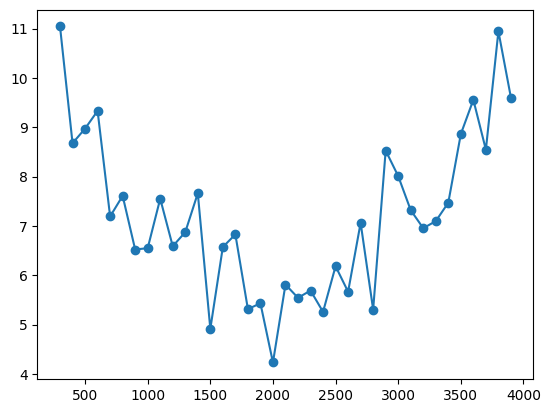

In [939]:
plt.plot(bandwidths, mse_para_list, marker='o')

In [928]:
mse_para_list_total = np.array(mse_para_list)

In [929]:
for i in range(7):
    X0 = 0
    T = 6000.0
    dt = 1/500
    t, X1 = euler_maruyama(alpha_func, B_func, h_func, X0, T, dt)
    t, X3 = euler_maruyama(alpha_func, B_func, h_func, X0, T, dt)
    X1 = X1 + 1j*X3
    t, X2 = complex_euler_maruyama(omega_func, c_func, A_func, X0+0j, T, dt)
    X = X1 + X2
    X = np.array([X[125*i] for i in range(int(4 * T))])

    bandwidths = np.arange(300, 4000, 100)
    mse_list = []
    mse_para_list = []
    mse_omega_list = []
    mse_c_list = []
    mse_A_list = []
    mse_B_list = []
    mse_h_list = []
    relative_omega_list = []
    relative_c_list = []
    relative_A_list = []
    relative_B_list = []
    relative_h_list = []
    relative_list = []

    Delta = 1.0

    for bw in bandwidths:
        # if bw <= 500:
        #     segments = [X[i:i + bw] for i in range(0, len(X) - bw, 150)]
        # elif 500 < bw < 1000:
        #     segments = [X[i:i + bw] for i in range(0, len(X) - bw, 150)]
        # else:
        #     segments = [X[i:i + bw] for i in range(0, len(X) - bw, 150)]
        segments = [X[i:i + bw] for i in range(0, len(X) - bw, 50)]
        total_loss = 0
        total_para_losss = 0
        total_relative_omega = 0
        total_relative_c = 0
        total_relative_A = 0
        total_relative_B = 0
        total_relative_h = 0
        total_relative = 0
        total_omega = 0
        total_c = 0
        total_A = 0
        total_B = 0
        total_h = 0
        count = 0

        for (t, segment) in enumerate(segments):
            periodogram = local_periodogram(segment, Delta)
            freqs = np.fft.fftshift(np.fft.fftfreq(len(segment), d=Delta))
            freqs *= 2 * np.pi
            omega_true = omega_func(int(t + len(segment) / 2))
            c_true = c_func(int(t + len(segment) / 2))
            A_true = A_func(int(t + len(segment) / 2))
            B_true = B_func(int(t + len(segment) / 2))
            h_true = h_func(int(t + len(segment) / 2))
            cf = cf_values[int(t + len(segment) / 2)]

            A, omega, c, B, alpha, h = LTD.MaternOUFit(segment, cf, 1, 1, 1, 1)

            if sum(np.isnan((A, omega, c, B, h))) == 0 and np.max((A, omega, c, B, h)) < 50:
            # if sum(np.isnan((A, omega, c, B, h))) == 0:
                count += 1
                model_spectrum = aggregate_spectral_density(freqs, omega, c, A, B, 1, h)
                mse = np.mean((periodogram - model_spectrum)**2) / len(periodogram)
                # mse = np.mean((periodogram/np.linalg.norm(periodogram) - model_spectrum/np.linalg.norm(periodogram))**2)
                mse_para = ((omega - omega_true)**2 + (c - c_true)**2 + (A - A_true)**2
                            + (B - B_true)**2 + (h - h_true)**2 + (alpha-1)**2) / 6
                mse_omega = (omega - omega_true)**2
                mse_c = (c - c_true)**2
                mse_A = (A - A_true)**2
                mse_B = (B - B_true)**2
                mse_h = (h - h_true)**2

                relative_omega = (omega - omega_true) / omega_true
                relative_c = (c - c_true) / c_true
                relative_A = (A - A_true)/ A_true
                relative_B = (B - B_true)/ B_true
                relative_h = (h - h_true)/ h_true
                relative = (relative_A + relative_h + relative_omega) / 5
                
                total_loss += mse
                total_para_losss += mse_para
                total_omega += mse_omega
                total_c += mse_c
                total_A += mse_A
                total_B += mse_B
                total_h += mse_h
                total_relative_omega += relative_omega
                total_relative_c += relative_c
                total_relative_A += relative_A
                total_relative_B += relative_B
                total_relative_h += relative_h
                total_relative += relative
                print(f"bw={bw}, t={t}, para={A, omega, c, B, alpha, h}")

        if count == 0:
            count += 1e-5
        avg_mse = total_loss / count
        avg_mse_para = total_para_losss / count
        mse_list.append(avg_mse)
        mse_para_list.append(avg_mse_para)
        mse_omega_list.append(total_omega / count)
        mse_c_list.append(total_c / count)
        mse_A_list.append(total_A / count)
        mse_B_list.append(total_B / count)
        mse_h_list.append(total_h / count)
        relative_omega_list.append(total_relative_omega / count)
        relative_c_list.append(total_relative_c / count)
        relative_A_list.append(total_relative_A / count)
        relative_B_list.append(total_relative_B / count)
        relative_h_list.append(total_relative_h / count)
        relative_list.append(total_relative / count)
        # print(f"bw={bw} finishied")

    mse_para_list_total += np.array(mse_para_list)
    print(f'finish loop {i}')

bw=300, t=0, para=(np.float64(0.009522955483484212), np.float64(0.6015087949628789), np.float64(1.6904012583040007e-05), np.float64(9.479656287095873), np.float64(1.0801695297567202), np.float64(0.062151472710287994))
bw=300, t=1, para=(np.float64(2.332318837438103e-05), np.float64(-0.24695896185376717), np.float64(0.2212959336935955), np.float64(9.731816328141067), np.float64(1.060220383124511), np.float64(0.056677528078968684))
bw=300, t=2, para=(np.float64(0.40936109308981583), np.float64(0.709499455503644), np.float64(0.01794893259588333), np.float64(10.40012174579976), np.float64(1.0443813730647302), np.float64(0.04201531278435989))
bw=300, t=3, para=(np.float64(0.24047162351494072), np.float64(0.6851847746128638), np.float64(0.00625558918260635), np.float64(10.284680150098977), np.float64(1.0593370505705486), np.float64(0.031073892620056047))
bw=300, t=4, para=(np.float64(4.0064817376838945e-07), np.float64(0.683027987351745), np.float64(0.2852714534597061), np.float64(10.5027218

In [931]:
optimal_bw = bandwidths[np.argmin(mse_para_list_total)]

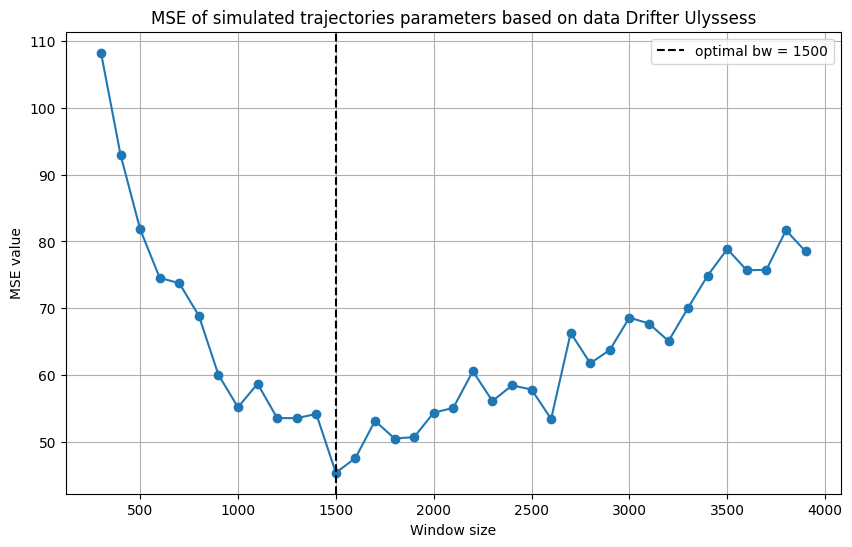

In [ ]:
plt.figure(figsize=(10, 6))
plt.plot(bandwidths, mse_para_list_total, marker='o')
plt.axvline(optimal_bw, color="k", linestyle="--",
            label=f"optimal bw = {optimal_bw}")
plt.ylabel('MSE value')
plt.xlabel('Window size')
plt.title("MSE of simulated trajectories parameters based on data Drifter Ulyssess")
plt.legend()
plt.grid()

In [1094]:
file_path = '/Users/syx/Desktop/Imperial College London UG/Year4/MATH70050 M4R/Lagrangian Time Series Models for Ocean Surface Drifter Trajectories/Magellan6p.mat'
try:
    mat_data = scipy.io.loadmat(file_path)
    print("MAT file successfully loaded with scipy.io.loadmat")
    print(mat_data.keys())  # Print available variables
except Exception as e:
    print(f"Error loading MAT file: {e}")

MAT file successfully loaded with scipy.io.loadmat
dict_keys(['__header__', '__version__', '__globals__', 'Ulysses6p'])


In [1095]:
cf_values = mat_data['Ulysses6p']['cf'][0][0][0]
A_values = mat_data['Ulysses6p']['param'][0][0][:,0]
omega_values = mat_data['Ulysses6p']['param'][0][0][:,1]
c_values = mat_data['Ulysses6p']['param'][0][0][:,2]
B_values = mat_data['Ulysses6p']['param'][0][0][:,3]
alpha_values = mat_data['Ulysses6p']['param'][0][0][:,4]
h_values = mat_data['Ulysses6p']['param'][0][0][:,5]

In [1125]:
coeffs = np.polyfit(np.arange(len(omega_values)), omega_values, 15)
poly_omega = np.poly1d(coeffs)

coeffs = np.polyfit(np.arange(len(A_values)), A_values, 15)
poly_A = np.poly1d(coeffs)

coeffs = np.polyfit(np.arange(len(B_values)), B_values, 15)
poly_B = np.poly1d(coeffs)

coeffs = np.polyfit(np.arange(len(c_values)), c_values, 15)
poly_c = np.poly1d(coeffs)

coeffs = np.polyfit(np.arange(len(h_values)), h_values, 15)
poly_h = np.poly1d(coeffs)

def omega_func(t):
    return poly_omega(t)

def A_func(t):
    return poly_A(t)

def B_func(t):
    return poly_B(t)

def c_func(t):
    return poly_c(t)

def h_func(t):
    return poly_h(t)

def alpha_func(t):
    return 1

In [1126]:
len(A_values)

18703

Text(0.5, 1.0, 'Interpolation to omega value')

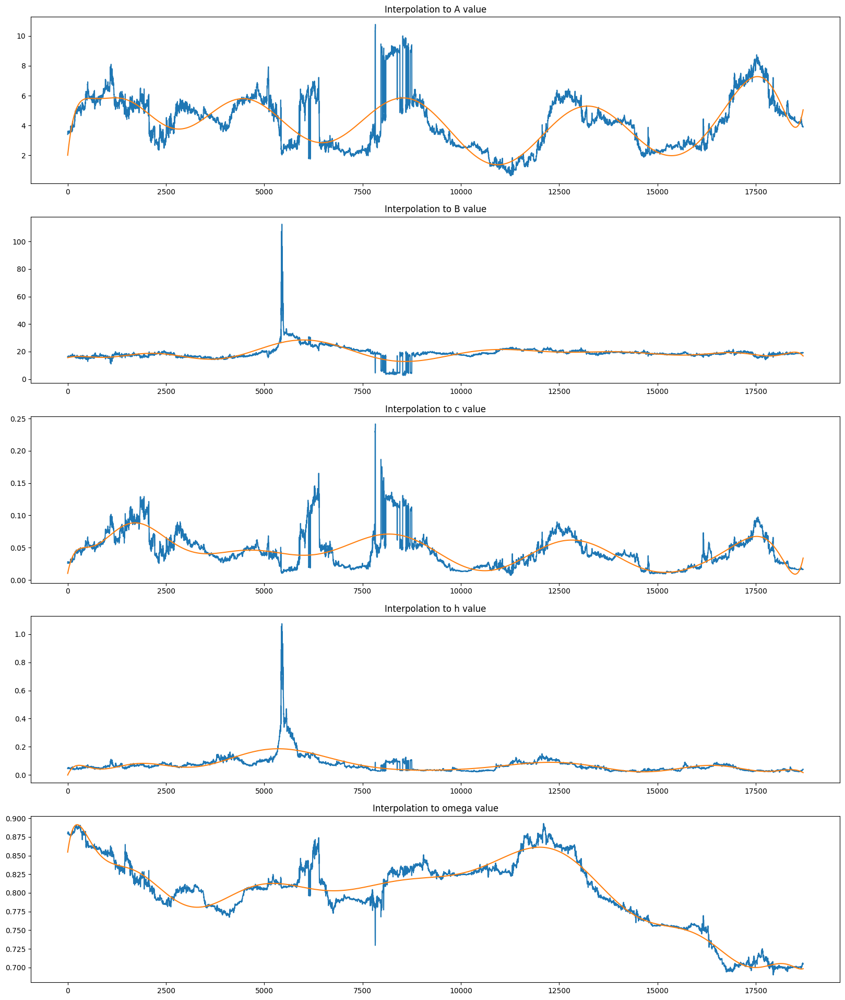

In [1138]:
plt.figure(figsize=(20, 24))

plt.subplot(5, 1, 1)
plt.plot(A_values)
plt.plot(A_func(np.arange(0, 18703, 1)))
plt.title('Interpolation to A value')

plt.subplot(5, 1, 2)
plt.plot(B_values)
plt.plot(B_func(np.arange(0, 18703, 1)))
plt.title('Interpolation to B value')

plt.subplot(5, 1, 3)
plt.plot(c_values)
plt.plot(c_func(np.arange(0, 18703, 1)))
plt.title('Interpolation to c value')

plt.subplot(5, 1, 4)
plt.plot(h_values)
plt.plot(h_func(np.arange(0, 18703, 1)))
plt.title('Interpolation to h value')

plt.subplot(5, 1, 5)
plt.plot(omega_values)
plt.plot(omega_func(np.arange(0, 18703, 1)))
plt.title('Interpolation to omega value')


In [1150]:
np.random.seed(1234)
X0 = 0
T = 3000.0
dt = 1/500
t, X1 = euler_maruyama(alpha_func, B_func, h_func, X0, T, dt)
t, X3 = euler_maruyama(alpha_func, B_func, h_func, X0, T, dt)
X1 = X1 + 1j*X3
t, X2 = complex_euler_maruyama(omega_func, c_func, A_func, X0+0j, T, dt)
X = X1 + X2
X = np.array([X[125*i] for i in range(int(4 * T))])

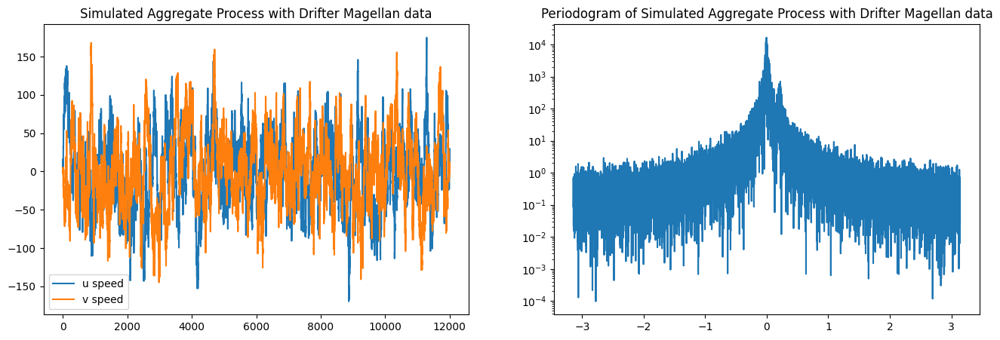

In [1151]:
plt.figure(figsize=(16, 5))
plt.subplot(1, 2, 1)
plt.plot(X.real, label='u speed')
plt.plot(X.imag, label='v speed')
plt.legend()
plt.title('Simulated Aggregate Process with Drifter Magellan data')

plt.subplot(1, 2, 2)
periodogram = (dt / T) * np.abs(np.fft.fft(X))**2
periodogram = np.fft.fftshift(periodogram)
freqs = np.fft.fftshift(np.fft.fftfreq(len(periodogram), d=Delta))
freqs *= 2 * np.pi
plt.plot(freqs, periodogram)
plt.yscale('log')
plt.title('Periodogram of Simulated Aggregate Process with Drifter Magellan data')

plt.show()

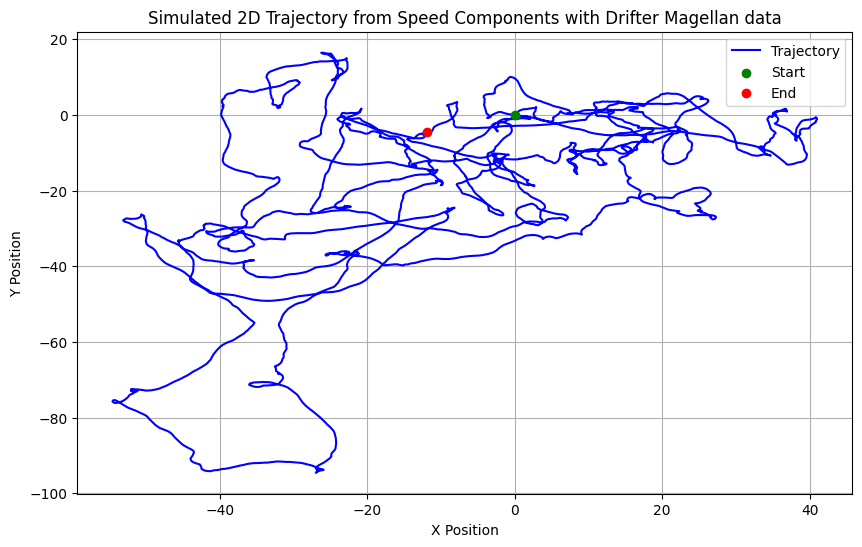

In [1152]:
import numpy as np
import matplotlib.pyplot as plt

# Define u and v as some example speed components
u = X.real  # Example x-direction velocity
v = X.imag  # Example y-direction velocity

# Compute positions by integrating u and v
x = np.cumsum(u) * dt  # Numerical integration (cumulative sum)
y = np.cumsum(v) * dt

# Plot the trajectory
plt.figure(figsize=(10, 6))
plt.plot(x, y, label="Trajectory", color="b")
plt.scatter(x[0], y[0], color="g", label="Start", zorder=3)
plt.scatter(x[-1], y[-1], color="r", label="End", zorder=3)
plt.xlabel("X Position")
plt.ylabel("Y Position")
plt.title("Simulated 2D Trajectory from Speed Components with Drifter Magellan data")
plt.legend()
plt.grid()
plt.show()

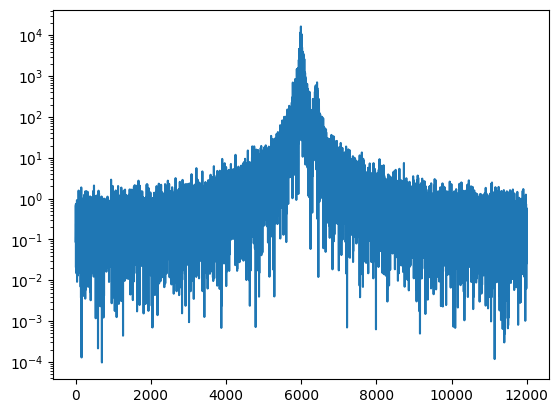

In [1153]:
periodogram = (dt / T) * np.abs(np.fft.fft(X))**2
periodogram = np.fft.fftshift(periodogram)
plt.plot(periodogram)
plt.yscale('log')

In [1154]:
bandwidths = np.arange(100, 4000, 100)
mse_list = []
mse_para_list = []
mse_omega_list = []
mse_c_list = []
mse_A_list = []
mse_B_list = []
mse_h_list = []
relative_omega_list = []
relative_c_list = []
relative_A_list = []
relative_B_list = []
relative_h_list = []
relative_list = []

Delta = 1.0

for bw in bandwidths:
    # if bw <= 500:
    #     segments = [X[i:i + bw] for i in range(0, len(X) - bw, 150)]
    # elif 500 < bw < 1000:
    #     segments = [X[i:i + bw] for i in range(0, len(X) - bw, 150)]
    # else:
    #     segments = [X[i:i + bw] for i in range(0, len(X) - bw, 150)]
    segments = [X[i:i + bw] for i in range(0, len(X) - bw, 200)]
    total_loss = 0
    total_para_losss = 0
    total_relative_omega = 0
    total_relative_c = 0
    total_relative_A = 0
    total_relative_B = 0
    total_relative_h = 0
    total_relative = 0
    total_omega = 0
    total_c = 0
    total_A = 0
    total_B = 0
    total_h = 0
    count = 0

    for (t, segment) in enumerate(segments):
        periodogram = local_periodogram(segment, Delta)
        freqs = np.fft.fftshift(np.fft.fftfreq(len(segment), d=Delta))
        freqs *= 2 * np.pi
        omega_true = omega_func(int(t + len(segment) / 2))
        c_true = c_func(int(t + len(segment) / 2))
        A_true = A_func(int(t + len(segment) / 2))
        B_true = B_func(int(t + len(segment) / 2))
        h_true = h_func(int(t + len(segment) / 2))
        cf = cf_values[int(t + len(segment) / 2)]

        A, omega, c, B, alpha, h = LTD.MaternOUFit(segment, cf, 1, 1, 1, 1)

        if sum(np.isnan((A, omega, c, B, h))) == 0 and np.max((A, omega, c, B, h)) < 50:
        # if sum(np.isnan((A, omega, c, B, h))) == 0:
            count += 1
            model_spectrum = aggregate_spectral_density(freqs, omega, c, A, B, 1, h)
            mse = np.mean((periodogram - model_spectrum)**2) / len(periodogram)
            # mse = np.mean((periodogram/np.linalg.norm(periodogram) - model_spectrum/np.linalg.norm(periodogram))**2)
            mse_para = ((omega - omega_true)**2 + (c - c_true)**2 + (A - A_true)**2
                        + (B - B_true)**2 + (h - h_true)**2 + (alpha-1)**2) / 6
            mse_omega = (omega - omega_true)**2
            mse_c = (c - c_true)**2
            mse_A = (A - A_true)**2
            mse_B = (B - B_true)**2
            mse_h = (h - h_true)**2

            relative_omega = (omega - omega_true) / omega_true
            relative_c = (c - c_true) / c_true
            relative_A = (A - A_true)/ A_true
            relative_B = (B - B_true)/ B_true
            relative_h = (h - h_true)/ h_true
            relative = (relative_A + relative_h + relative_omega) / 5
            
            total_loss += mse
            total_para_losss += mse_para
            total_omega += mse_omega
            total_c += mse_c
            total_A += mse_A
            total_B += mse_B
            total_h += mse_h
            total_relative_omega += relative_omega
            total_relative_c += relative_c
            total_relative_A += relative_A
            total_relative_B += relative_B
            total_relative_h += relative_h
            total_relative += relative
            # print(f"bw={bw}, t={t}, para={A, omega, c, B, alpha, h}")

    if count == 0:
        count += 1e-5
    avg_mse = total_loss / count
    avg_mse_para = total_para_losss / count
    mse_list.append(avg_mse)
    mse_para_list.append(avg_mse_para)
    mse_omega_list.append(total_omega / count)
    mse_c_list.append(total_c / count)
    mse_A_list.append(total_A / count)
    mse_B_list.append(total_B / count)
    mse_h_list.append(total_h / count)
    relative_omega_list.append(total_relative_omega / count)
    relative_c_list.append(total_relative_c / count)
    relative_A_list.append(total_relative_A / count)
    relative_B_list.append(total_relative_B / count)
    relative_h_list.append(total_relative_h / count)
    relative_list.append(total_relative / count)
    # print(f"bw={bw} finishied")

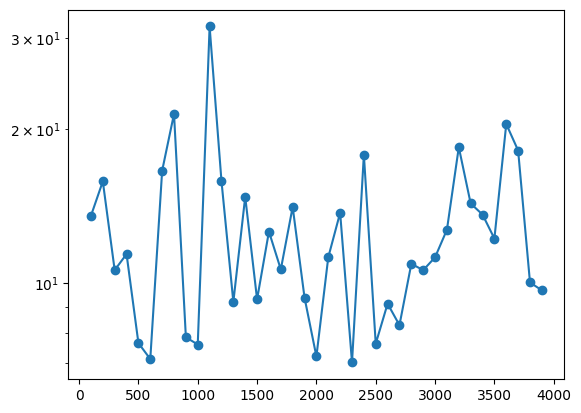

In [1155]:
plt.plot(bandwidths, mse_para_list, marker='o')
plt.yscale('log')

In [1156]:
mse_para_list_total = np.array(mse_para_list)

In [1161]:
for i in range(7):
    X0 = 0
    T = 3000.0
    dt = 1/500
    t, X1 = euler_maruyama(alpha_func, B_func, h_func, X0, T, dt)
    t, X3 = euler_maruyama(alpha_func, B_func, h_func, X0, T, dt)
    X1 = X1 + 1j*X3
    t, X2 = complex_euler_maruyama(omega_func, c_func, A_func, X0+0j, T, dt)
    X = X1 + X2
    X = np.array([X[125*i] for i in range(int(4 * T))])

    bandwidths = np.arange(100, 4000, 100)
    mse_list = []
    mse_para_list = []
    mse_omega_list = []
    mse_c_list = []
    mse_A_list = []
    mse_B_list = []
    mse_h_list = []
    relative_omega_list = []
    relative_c_list = []
    relative_A_list = []
    relative_B_list = []
    relative_h_list = []
    relative_list = []

    Delta = 1.0

    for bw in bandwidths:
        # if bw <= 500:
        #     segments = [X[i:i + bw] for i in range(0, len(X) - bw, 150)]
        # elif 500 < bw < 1000:
        #     segments = [X[i:i + bw] for i in range(0, len(X) - bw, 150)]
        # else:
        #     segments = [X[i:i + bw] for i in range(0, len(X) - bw, 150)]
        segments = [X[i:i + bw] for i in range(0, len(X) - bw, 200)]
        total_loss = 0
        total_para_losss = 0
        total_relative_omega = 0
        total_relative_c = 0
        total_relative_A = 0
        total_relative_B = 0
        total_relative_h = 0
        total_relative = 0
        total_omega = 0
        total_c = 0
        total_A = 0
        total_B = 0
        total_h = 0
        count = 0

        for (t, segment) in enumerate(segments):
            periodogram = local_periodogram(segment, Delta)
            freqs = np.fft.fftshift(np.fft.fftfreq(len(segment), d=Delta))
            freqs *= 2 * np.pi
            omega_true = omega_func(int(t + len(segment) / 2))
            c_true = c_func(int(t + len(segment) / 2))
            A_true = A_func(int(t + len(segment) / 2))
            B_true = B_func(int(t + len(segment) / 2))
            h_true = h_func(int(t + len(segment) / 2))
            cf = cf_values[int(t + len(segment) / 2)]

            A, omega, c, B, alpha, h = LTD.MaternOUFit(segment, cf, 1, 1, 1, 1)

            if sum(np.isnan((A, omega, c, B, h))) == 0 and np.max((A, omega, c, B, h)) < 50:
            # if sum(np.isnan((A, omega, c, B, h))) == 0:
                count += 1
                model_spectrum = aggregate_spectral_density(freqs, omega, c, A, B, 1, h)
                mse = np.mean((periodogram - model_spectrum)**2) / len(periodogram)
                # mse = np.mean((periodogram/np.linalg.norm(periodogram) - model_spectrum/np.linalg.norm(periodogram))**2)
                mse_para = ((omega - omega_true)**2 + (c - c_true)**2 + (A - A_true)**2
                            + (B - B_true)**2 + (h - h_true)**2 + (alpha-1)**2) / 6
                mse_omega = (omega - omega_true)**2
                mse_c = (c - c_true)**2
                mse_A = (A - A_true)**2
                mse_B = (B - B_true)**2
                mse_h = (h - h_true)**2

                relative_omega = (omega - omega_true) / omega_true
                relative_c = (c - c_true) / c_true
                relative_A = (A - A_true)/ A_true
                relative_B = (B - B_true)/ B_true
                relative_h = (h - h_true)/ h_true
                relative = (relative_A + relative_h + relative_omega) / 5
                
                total_loss += mse
                total_para_losss += mse_para
                total_omega += mse_omega
                total_c += mse_c
                total_A += mse_A
                total_B += mse_B
                total_h += mse_h
                total_relative_omega += relative_omega
                total_relative_c += relative_c
                total_relative_A += relative_A
                total_relative_B += relative_B
                total_relative_h += relative_h
                total_relative += relative
                # print(f"bw={bw}, t={t}, para={A, omega, c, B, alpha, h}")

        if count == 0:
            count += 1e-5
        avg_mse = total_loss / count
        avg_mse_para = total_para_losss / count
        mse_list.append(avg_mse)
        mse_para_list.append(avg_mse_para)
        mse_omega_list.append(total_omega / count)
        mse_c_list.append(total_c / count)
        mse_A_list.append(total_A / count)
        mse_B_list.append(total_B / count)
        mse_h_list.append(total_h / count)
        relative_omega_list.append(total_relative_omega / count)
        relative_c_list.append(total_relative_c / count)
        relative_A_list.append(total_relative_A / count)
        relative_B_list.append(total_relative_B / count)
        relative_h_list.append(total_relative_h / count)
        relative_list.append(total_relative / count)
        # print(f"bw={bw} finishied")

    mse_para_list_total += np.array(mse_para_list)
    print(f'finish loop {i}')

finish loop 0
finish loop 1
finish loop 2
finish loop 3
finish loop 4
finish loop 5
finish loop 6


/var/folders/jv/kbv3tys55vsfc42p_y7b4rkw0000gn/T/ipykernel_44675/3019890869.py:8: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


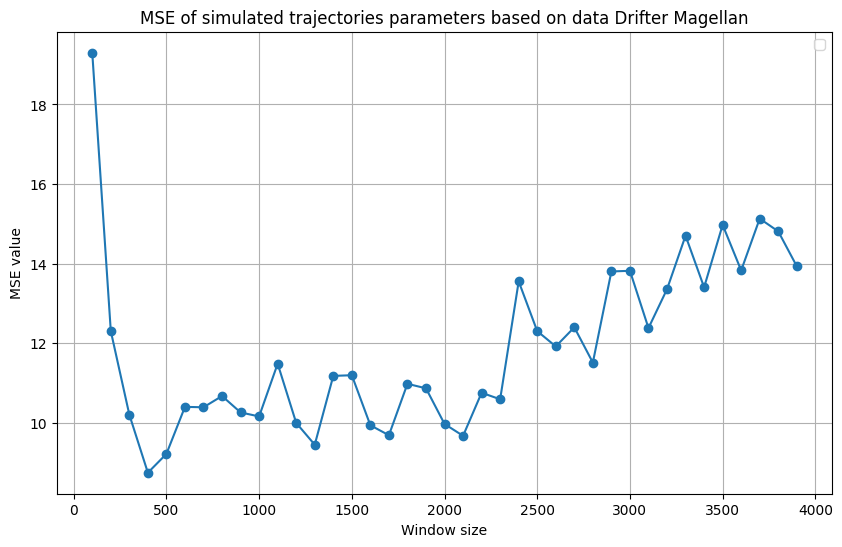

In [1163]:
plt.figure(figsize=(10, 6))
plt.plot(bandwidths, mse_para_list_total/22, marker='o')
# plt.axvline(optimal_bw, color="k", linestyle="--",
#             label=f"optimal bw = {optimal_bw}")
plt.ylabel('MSE value')
plt.xlabel('Window size')
plt.title("MSE of simulated trajectories parameters based on data Drifter Magellan")
plt.legend()
plt.grid()

/var/folders/jv/kbv3tys55vsfc42p_y7b4rkw0000gn/T/ipykernel_44675/3085184731.py:8: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


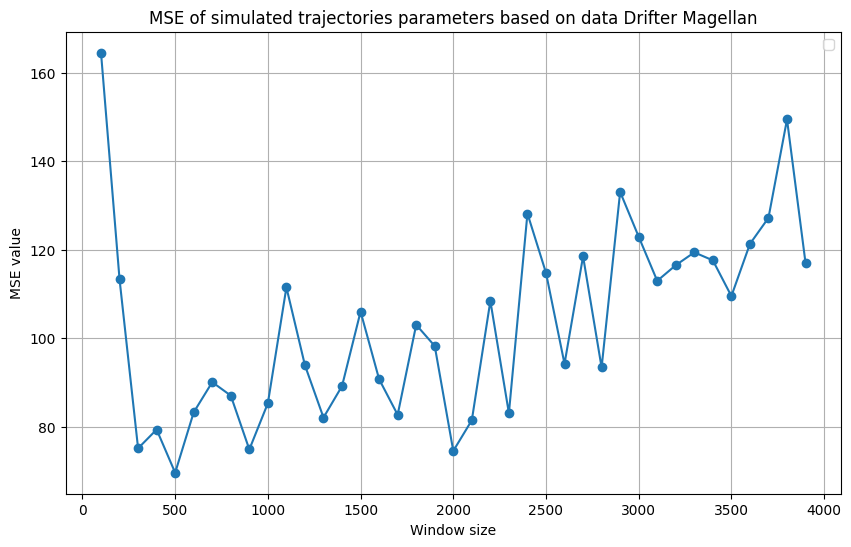

In [1158]:
plt.figure(figsize=(10, 6))
plt.plot(bandwidths, mse_para_list_total, marker='o')
# plt.axvline(optimal_bw, color="k", linestyle="--",
#             label=f"optimal bw = {optimal_bw}")
plt.ylabel('MSE value')
plt.xlabel('Window size')
plt.title("MSE of simulated trajectories parameters based on data Drifter Magellan")
plt.legend()
plt.grid()

In [1164]:
file_path = '/Users/syx/Desktop/Imperial College London UG/Year4/MATH70050 M4R/Lagrangian Time Series Models for Ocean Surface Drifter Trajectories/Nansen6p.mat'
try:
    mat_data = scipy.io.loadmat(file_path)
    print("MAT file successfully loaded with scipy.io.loadmat")
    print(mat_data.keys())  # Print available variables
except Exception as e:
    print(f"Error loading MAT file: {e}")

MAT file successfully loaded with scipy.io.loadmat
dict_keys(['__header__', '__version__', '__globals__', 'Ulysses6p'])


In [1165]:
cf_values = mat_data['Ulysses6p']['cf'][0][0][0]
A_values = mat_data['Ulysses6p']['param'][0][0][:,0]
omega_values = mat_data['Ulysses6p']['param'][0][0][:,1]
c_values = mat_data['Ulysses6p']['param'][0][0][:,2]
B_values = mat_data['Ulysses6p']['param'][0][0][:,3]
alpha_values = mat_data['Ulysses6p']['param'][0][0][:,4]
h_values = mat_data['Ulysses6p']['param'][0][0][:,5]

In [1166]:
coeffs = np.polyfit(np.arange(len(omega_values)), omega_values, 15)
poly_omega = np.poly1d(coeffs)

coeffs = np.polyfit(np.arange(len(A_values)), A_values, 15)
poly_A = np.poly1d(coeffs)

coeffs = np.polyfit(np.arange(len(B_values)), B_values, 15)
poly_B = np.poly1d(coeffs)

coeffs = np.polyfit(np.arange(len(c_values)), c_values, 15)
poly_c = np.poly1d(coeffs)

coeffs = np.polyfit(np.arange(len(h_values)), h_values, 15)
poly_h = np.poly1d(coeffs)

def omega_func(t):
    return poly_omega(t)

def A_func(t):
    return poly_A(t)

def B_func(t):
    return poly_B(t)

def c_func(t):
    return poly_c(t)

def h_func(t):
    return poly_h(t)

def alpha_func(t):
    return 1

In [1167]:
len(A_values)

8714

Text(0.5, 1.0, 'Interpolation to omega value')

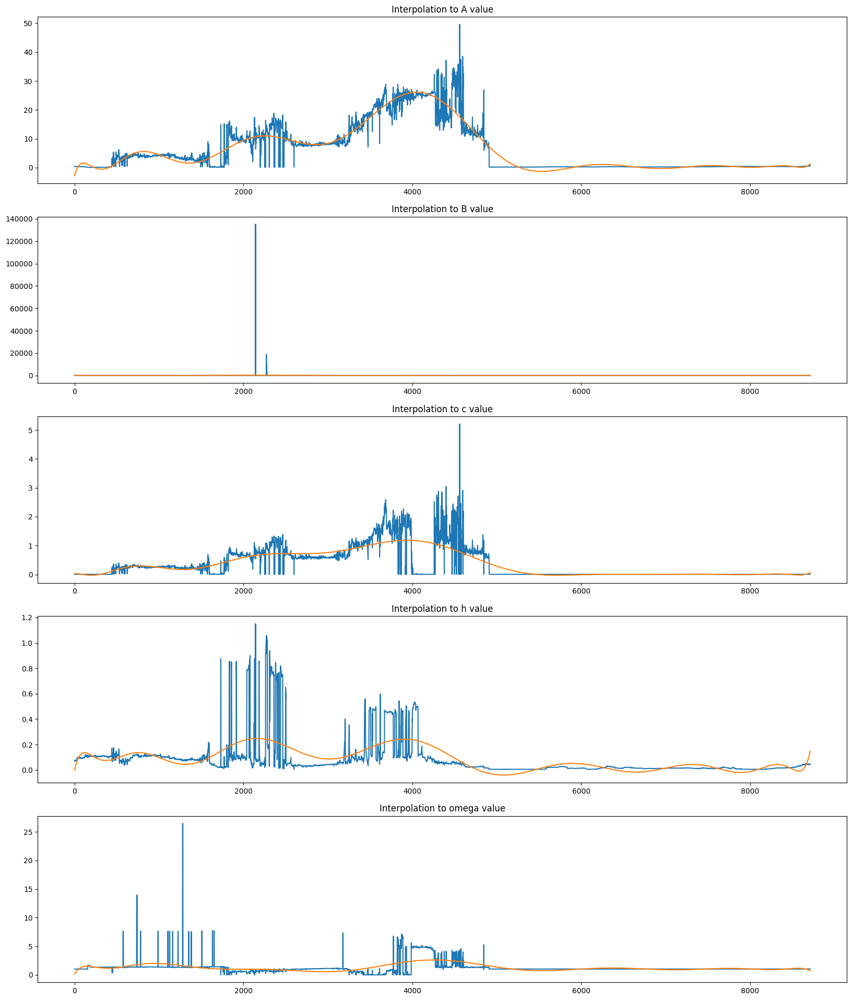

In [1168]:
plt.figure(figsize=(20, 24))

plt.subplot(5, 1, 1)
plt.plot(A_values)
plt.plot(A_func(np.arange(0, 8714, 1)))
plt.title('Interpolation to A value')

plt.subplot(5, 1, 2)
plt.plot(B_values)
plt.plot(B_func(np.arange(0, 8714, 1)))
plt.title('Interpolation to B value')

plt.subplot(5, 1, 3)
plt.plot(c_values)
plt.plot(c_func(np.arange(0, 8714, 1)))
plt.title('Interpolation to c value')

plt.subplot(5, 1, 4)
plt.plot(h_values)
plt.plot(h_func(np.arange(0, 8714, 1)))
plt.title('Interpolation to h value')

plt.subplot(5, 1, 5)
plt.plot(omega_values)
plt.plot(omega_func(np.arange(0, 8714, 1)))
plt.title('Interpolation to omega value')
